# Проект: Рынок заведений общественного питания Москвы

## Введение

**Описание проекта**

*Инвесторы из фонда «Shut Up and Take My Money» решили попробовать себя в новой области и открыть заведение общественного питания в Москве. Заказчики ещё не знают, что это будет за место: кафе, ресторан, пиццерия, паб или бар, — и какими будут расположение, меню и цены.*

*Для начала они просят вас — аналитика — подготовить исследование рынка Москвы, найти интересные особенности и презентовать полученные результаты, которые в будущем помогут в выборе подходящего инвесторам места.*

### Описание данных

Для анализа предоставлен датасет с заведениями общественного питания Москвы, составленный на основе данных сервисов Яндекс Карты и Яндекс Бизнес на лето 2022 года. Информация, размещённая в сервисе Яндекс Бизнес, могла быть добавлена пользователями или найдена в общедоступных источниках. Она носит исключительно справочный характер.

**Описание данных**

Файл `moscow_places.csv`:
- `name` — название заведения;
- `address` — адрес заведения;
- `category` — категория заведения, например «кафе», «пиццерия» или «кофейня»;
- `hours` — информация о днях и часах работы;
- `lat` — широта географической точки, в которой находится заведение;
- `lng` — долгота географической точки, в которой находится заведение;
- `rating` — рейтинг заведения по оценкам пользователей в Яндекс Картах (высшая оценка — 5.0);
- `price` — категория цен в заведении, например «средние», «ниже среднего», «выше среднего» и так далее;
- `avg_bill` — строка, которая хранит среднюю стоимость заказа в виде диапазона, например:
    - «Средний счёт: 1000–1500 ₽»;
    - «Цена чашки капучино: 130–220 ₽»;
    - «Цена бокала пива: 400–600 ₽».
- `middle_avg_bill` — число с оценкой среднего чека, которое указано только для значений из столбца avg_bill, начинающихся с подстроки «Средний счёт»:
    - Если в строке указан ценовой диапазон из двух значений, в столбец войдёт медиана этих двух значений.
    - Если в строке указано одно число — цена без диапазона, то в столбец войдёт это число.
    - Если значения нет или оно не начинается с подстроки «Средний счёт», то в столбец ничего не войдёт.
- `middle_coffee_cup` — число с оценкой одной чашки капучино, которое указано только для значений из столбца avg_bill, начинающихся с подстроки «Цена одной чашки капучино»:
    - Если в строке указан ценовой диапазон из двух значений, в столбец войдёт медиана этих двух значений.
    - Если в строке указано одно число — цена без диапазона, то в столбец войдёт это число.
    - Если значения нет или оно не начинается с подстроки «Цена одной чашки капучино», то в столбец ничего не войдёт.
- `chain` — число, выраженное 0 или 1, которое показывает, является ли заведение сетевым (для маленьких сетей могут встречаться ошибки):
    - 0 — заведение не является сетевым
    - 1 — заведение является сетевым
- `district` — административный район, в котором находится заведение, например Центральный административный округ;
- `seats` — количество посадочных мест.

## Загрузка и предобработка данных

### Загрузка данных, общее ознакомление

#### Установка и импорт библиотек, загрузка файла данных

In [1]:
# установка библиотек
!pip install missingno
!pip install folium

Defaulting to user installation because normal site-packages is not writeable
Defaulting to user installation because normal site-packages is not writeable


In [2]:
# импорт бибилиотек

import pandas as pd
import os
import datetime as dt

import numpy as np
from statistics import median

import matplotlib.pyplot as plt
import plotly.express as px
from plotly import graph_objects as go
import seaborn as sns

import json

import folium
from folium import Map, Choropleth, Marker
from folium.plugins import MarkerCluster
from folium.features import CustomIcon

import missingno as msno

print('Библиотеки импортированы')

Библиотеки импортированы


In [3]:
# загрузка данных

if os.path.exists('/datasets/moscow_places.csv'):
    data = pd.read_csv('/datasets/moscow_places.csv')
    print('Файл загружен')
elif os.path.exists('moscow_places.csv'):
    data = pd.read_csv('moscow_places.csv')
    print('Файл загружен')
else:
    print('Файл отсутствует')

Файл загружен


#### Общее ознакомление с данными

In [4]:
# просмотр первых строк таблицы

data.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0


In [5]:
# ознакомление с общей информацией о таблице

data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


In [6]:
# проверка данных на наличие явных дубликатов и пропусков

print(f'В таблице найдено {data.duplicated().sum()} дубликатов и {data.isna().sum().sum()} пропусков данных.')

В таблице найдено 0 дубликатов и 26956 пропусков данных.


Таблица содержит 8406 строк и 14 столбцов. Явных дубликатов в таблице нет, но содержится большое количество пропусков. Рассмотрим их.

In [7]:
# подсчет количества пропущенных значений в столбцах в процентах от общего количества данных
round(100*data.isna().sum() / len(data), 2)

name                  0.00
category              0.00
address               0.00
district              0.00
hours                 6.38
lat                   0.00
lng                   0.00
rating                0.00
price                60.56
avg_bill             54.60
middle_avg_bill      62.54
middle_coffee_cup    93.64
chain                 0.00
seats                42.96
dtype: float64

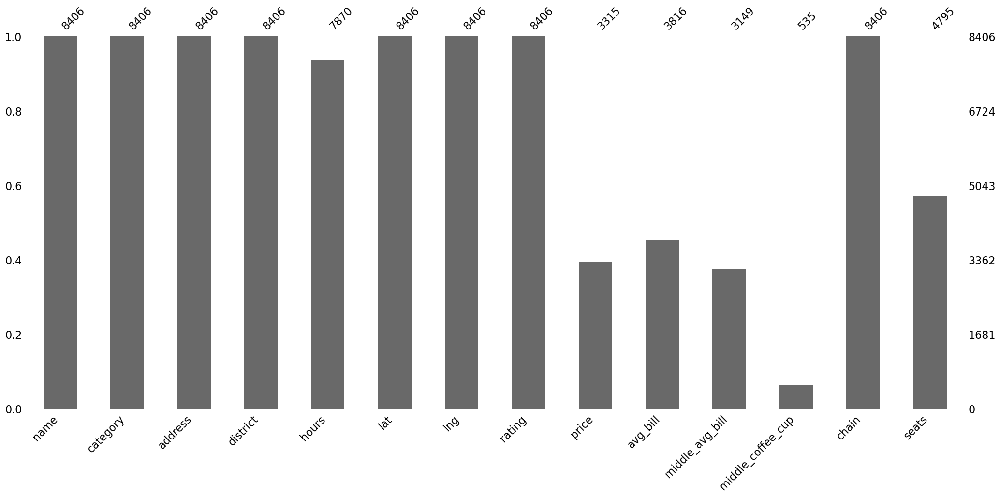

In [8]:
# визуализация пропусков
msno.bar(data)
None

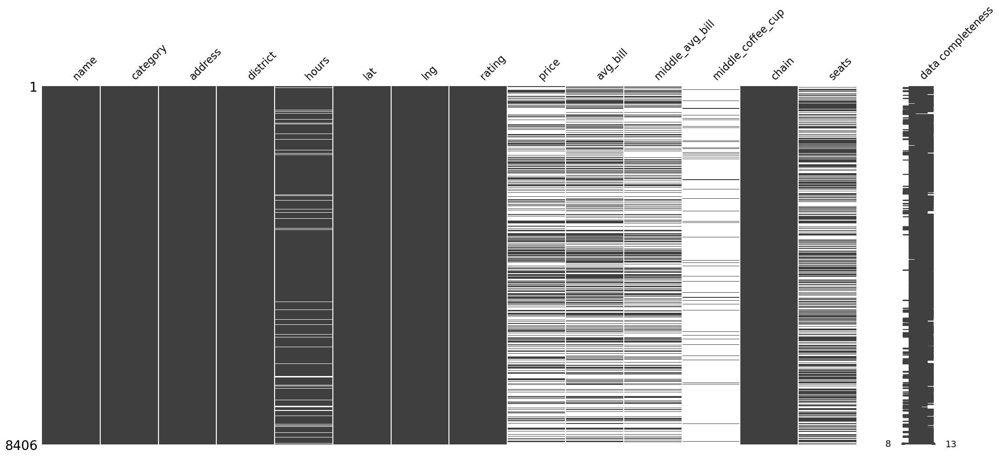

In [9]:
# визуализация пропусков
msno.matrix(data, labels=True)
None

Пропуски обнаружены в 6 столбцах:
- `hours`: пропущено 6,38% данных. Пропусков немного, рапределены они неравномерно. Данных для корректного заполнения пропусков нет, оставляем их без обработки.
- `price`: пропущено 60,56% процентов данных. Пропусков много, распределены равномерно. Факторов, влияющих на уровень цен в заведении, много, и не все они учтены в таблице, поэтому достоверно заполнить пропуски на основе имеющихся данных мы не можем. Оставляем пропуски без обработки.
- `avg_bill`: пропущено 54,60% данных. Пропусков много, распределены равномерно. Заполнить пропуски на основе данных о других заведениях мы не можем, так как на формирование цен может влиять огромный набор факторов. Оставляем пропуски без обработки.
- `middle_avg_bill`: пропущено 62,54% данных. Пропусков много, распределены равномерно. Столбец заполянется на основе данных из столбца `avg_bill`, поэтому заполнить пропуски мы не можем. Оставляем пропуски без обработки.
- `middle_coffee_cup`: пропущено 93,64% данных. Предполагаем, что такой большой процент пропусков объясняется небольшим наличием кофеен в таблице (также у части кофеен в столбце `avg_bill` мог быть указан размер среднего чека, а не цена чашки капучино). Столбец заполянется на основе данных из столбца `avg_bill`, поэтому заполнить пропуски мы не можем. Оставляем пропуски без обработки.
- `seats`: пропущено 42,96% данных. Пропусков много, распределены равномерно. Данных для заполнения пропусков у нас нет, оставляем пропуски без обработки.

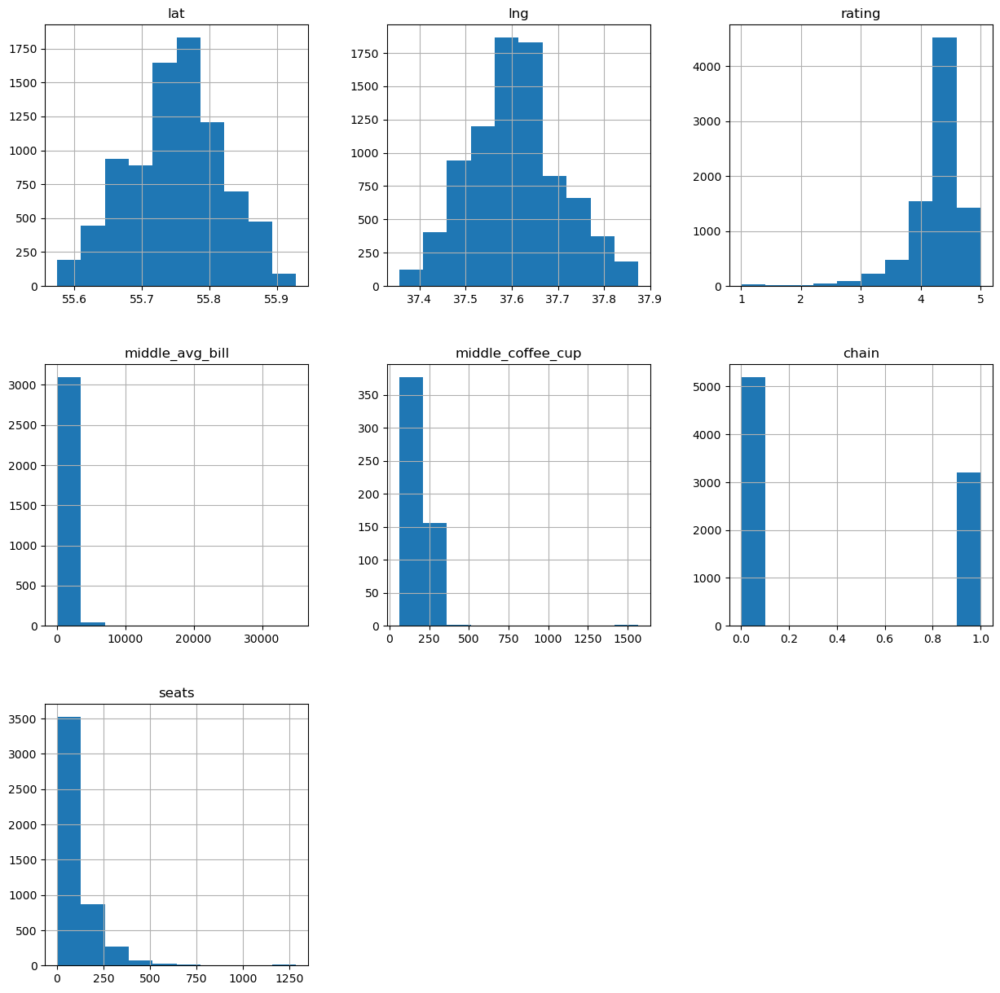

In [10]:
# распределение данных в таблице
data.hist(figsize=(15, 15))
None

1. Столбцы `lat` и `lng`: данные распределены нормально (неравномерно). Аномальных значений нет. Пики в центре, вероятнее всего, отображают более плотную концентрацию заведений в центре Москвы.
2. Столбец `rating`: данные распределены неравномерно. Большая часть заведений имеет оценку 4,5. Аномальных значений и выбросов нет.
3. Столбец `middle_avg_bill`: данные распределены неравномерно, присутствуют выбросы.
4. Столбец `middle_coffee_cup`: данные распределены неравномерно, присутствуют выбросы.
5. Столбец `chain`: данные распределены по двум значениям. Несетевых заведений в таблице представлено больше, чем сетевых. Аномальных значений нет.
6. Столбец `seats`: данные распределены неравномерно, присутствуют выбросы.

#### Итоги ознакомления

- таблица содержит данные о заведениях общественного питания Москвы, содержит 8406 строк и 14 столбцов
- в 6 столбцах есть пропуски, большинство из которых заполнить не представляется возможным
- в 3 столбцах есть аномальные значения (выбросы)

#### План работ по предобработке данных

- `address` - выделим столбец с наименованием улицы
- `hours` - выделим столбец с признаком круглосуточной работы
- `lat`, `lng` - проверим распределение и полноту данных, а также наличие неявных дубликатов
- `middle_avg_bill` - удалим выбросы
- `middle_coffee_cup` - удалим выбросы
- `seats` - удалим выбросы

### Предобработка данных

#### Столбец `address`

In [11]:
# выделяем отдельный столбец с наименованием улицы
data['street'] = data['address'].str.split(',', expand=True)[1].str.lstrip()

#### Столбец `hours` 

In [12]:
# добавляем столбец с признаком круглосуточной работы
data['is_24/7'] = data.loc[:, ['hours']].apply(lambda row: 'ежедневно, круглосуточно' in str(row['hours']), axis=1)

#### Столбцы `lat`, `lng`

Построим диаграмму рассеяния, чтобы оценить полноту данных.

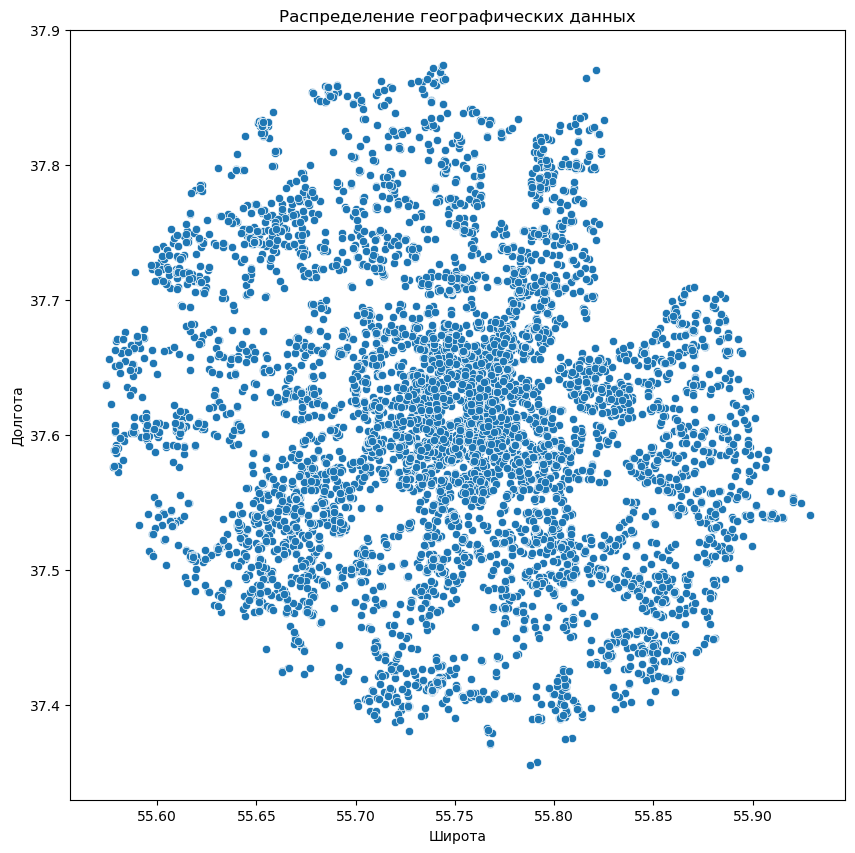

In [13]:
plt.figure(figsize=(10,10))
sns.scatterplot(x='lat', y='lng', data=data) 
plt.title('Распределение географических данных')
plt.xlabel('Широта')
plt.ylabel('Долгота')
plt.show()

Диаграмма рассеяния очертаниями напоминает карту Москвы в пределах МКАД. Белые пятна на диаграмме примерно совпадают с расположением крупных парков. Аномальных выбросов нет, данные корректны.

Ранее мы отметили, что явных дубликатов в таблице нет. Однако в таблицу могли попасть дубликаты неявные - заведения, находящиеся в одной географической точке, но с разными наименованиями. Проверим, есть ли в таблице такие заведения.

In [14]:
data.groupby(['lat','lng']).agg(count=('name', 'count'), first=('name', 'first'), last=('name', 'last')).reset_index().query('count > 1').sort_values(by='count', ascending=False)

,lat,lng,count,first,last
2147,55.706883,37.592096,3,Франклинс Бургер,Laserland кафе
1261,55.670021,37.552480,3,Кофе,Суши Мания
169,55.607489,37.532367,2,Кофешефф,Крошка Картошка
6640,55.805361,37.708967,2,Прошу к столу,Хинкальная
4672,55.761690,37.658536,2,Стейк & Бургер,Soul in the Bowl
4763,55.762784,37.594602,2,Ava,Patriki
5588,55.780218,37.593084,2,Бансонс Бургер Китчен,Лепим и Варим
5713,55.782729,37.513952,2,Кафе-кулинария Сикварули,Сикварули
5968,55.788610,37.783970,2,Чайхана Doner кафе,Чайхана Döner
6687,55.806307,37.497566,2,More poke,More Poke


In [15]:
print(f"Количество неявных дубликатов: {len(data.groupby(['lat','lng']).agg(count=('name', 'count'), first=('name', 'first'), last=('name', 'last')).reset_index().query('count > 1').sort_values(by='count', ascending=False))}")
print(f"Уникальных наименований заведений в таблице: {data['name'].nunique()}")

Количество неявных дубликатов: 32
Уникальных наименований заведений в таблице: 5614


Задублировано 32 комбинации широты и долготы. Основные версии:
- заведения очень близко расположены друг к другу (например, соседние точки на фудкорте торгового центра)
- одно заведение закрылось, на его месте открылось другое, а в базе данных остались оба
- технические ошибки:
    - наименование дублируется на латинице (*Leon* и *Леон*)
    - одно из наименований является названием типа заведения (*Кафе* и *Халяль Кафе-Пекарня*, *Хинкальная* и *Старый дворик*)
    - использован разный регистр (*More poke* и *More Poke*)
    - вместо названия в таблицу внесены какие-то другие данные (*Папа Джонс* и *Кравченко 8 СТР. 6*)

Так как данные формируются в том числе и пользователями, появление разного рода ошибок неизбежно. Очистка данных от них может занять много времени и не имеет практического смысла в рамках поставленной задачи. Отметим наличие таких дублей и оставим их без обработки.

#### Столбец `middle_avg_bill`

На гистограмме мы видели наличие выбросов. Изучим данные в столбце.

In [16]:
data['middle_avg_bill'].describe()

count     3149.000000
mean       958.053668
std       1009.732845
min          0.000000
25%        375.000000
50%        750.000000
75%       1250.000000
max      35000.000000
Name: middle_avg_bill, dtype: float64

Минимальная сумма - 0 рублей. Это, скорее всего, ошибка.

Максимальная сумма - 35000 рублей. Вероятно, настолько дорогие заведения в Москве есть, но для нашего случая это аномалия.

Оценим количество аномальных  строк и удалим их. Срез по верхней границе будем проводить по значению 99 перцентиля.

In [17]:
print(f"Количество заведений, для которых указана сумма среднего чека 0 рублей: {len(data.query('middle_avg_bill == 0'))}.")
data = data.drop(data[data['middle_avg_bill'] == 0].index)
print(f"Ошибочные строки удалены. В таблице осталось {len(data)} строк.")

Количество заведений, для которых указана сумма среднего чека 0 рублей: 1.
Ошибочные строки удалены. В таблице осталось 8405 строк.


In [18]:
print(f"Значение 99 перцентиля по столбцу middle_avg_bill: {np.nanpercentile(data['middle_avg_bill'], 99)}.")
print(f"Будет удалено {len(data[data['middle_avg_bill'] > np.nanpercentile(data['middle_avg_bill'], 99)])} строк, что составляет {round(100*len(data[data['middle_avg_bill'] > np.nanpercentile(data['middle_avg_bill'], 99)])/len(data), 2)}% данных.")
data = data.drop(data[data['middle_avg_bill'] > np.nanpercentile(data['middle_avg_bill'], 99)].index)
print(f"Строки с выборосами удалены. В таблице осталось {len(data)} строк.")


Значение 99 перцентиля по столбцу middle_avg_bill: 3750.0.
Будет удалено 30 строк, что составляет 0.36% данных.
Строки с выборосами удалены. В таблице осталось 8375 строк.


Данных удалено немного, а верхняя граница вполне соответствует среднему чеку в ресторанах. Рассмотрим гистограмму по очищенным данным.

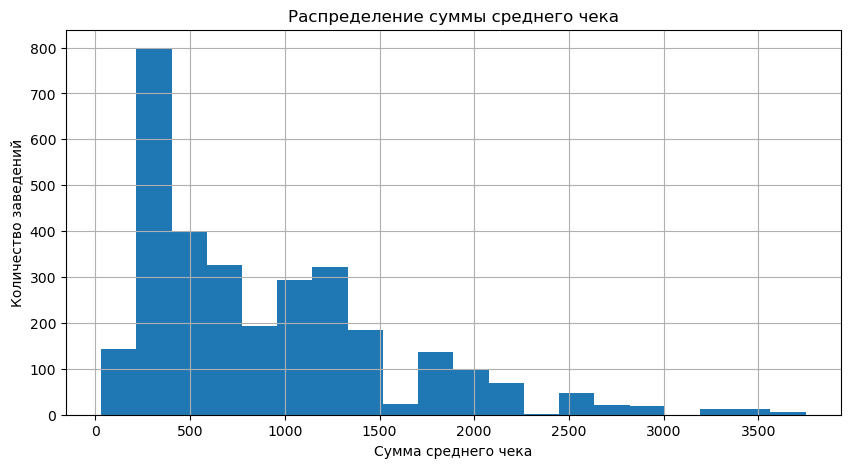

In [19]:
data['middle_avg_bill'].hist(bins=20, figsize=(10,5))
plt.title('Распределение суммы среднего чека')
plt.xlabel('Сумма среднего чека')
plt.ylabel('Количество заведений')
plt.show()

Выбросы устранены.

#### Столбец `middle_coffee_cup`

На гистограмме мы видели наличие выбросов. Изучим данные в столбце.

In [20]:
data['middle_coffee_cup'].describe()

count     535.000000
mean      174.721495
std        88.951103
min        60.000000
25%       124.500000
50%       169.000000
75%       225.000000
max      1568.000000
Name: middle_coffee_cup, dtype: float64

Минимальная стоимость чашки кофе - 60 рублей.

Максимальная стоимость - 1568 рублей. Значение вполне может отражать реальность, но для нашего случая - это выброс.

Оценим количество аномальных строк и удалим их. Как и в случае со средним чеком, срез по верхней границе будем проводить по 99 перцентилю.

In [21]:
print(f"Значение 99 перцентиля по столбцу middle_coffee_cup: {np.nanpercentile(data['middle_coffee_cup'], 99)}.")
print(f"Будет удалено {len(data[data['middle_coffee_cup'] > np.nanpercentile(data['middle_coffee_cup'], 99)])} строк, что составляет {round(100*len(data[data['middle_coffee_cup'] > np.nanpercentile(data['middle_coffee_cup'], 99)])/len(data), 2)}% данных.")
data = data.drop(data[data['middle_coffee_cup'] > np.nanpercentile(data['middle_coffee_cup'], 99)].index)
print(f"Строки с выборосами удалены. В таблице осталось {len(data)} строк.")

Значение 99 перцентиля по столбцу middle_coffee_cup: 309.8999999999995.
Будет удалено 6 строк, что составляет 0.07% данных.
Строки с выборосами удалены. В таблице осталось 8369 строк.


Рассмотрим гистограмму по очищенным данным.

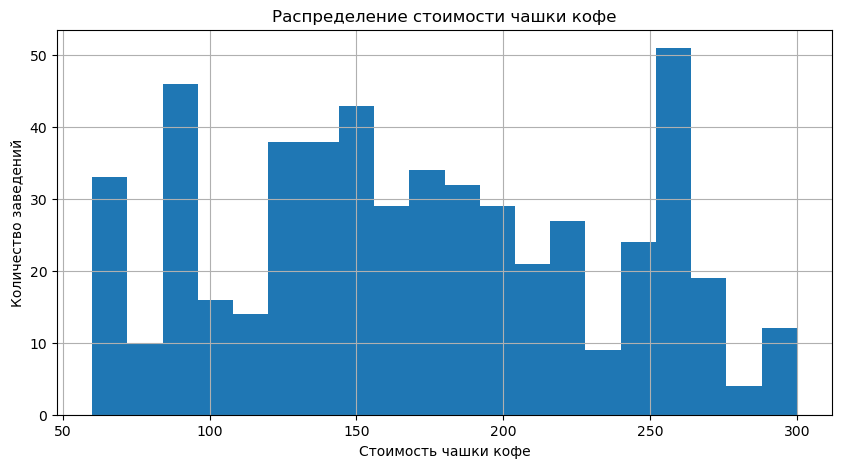

In [22]:
data['middle_coffee_cup'].hist(bins=20, figsize=(10,5))
plt.title('Распределение стоимости чашки кофе')
plt.xlabel('Стоимость чашки кофе')
plt.ylabel('Количество заведений')
plt.show()

Выбросы устранены.

#### Столбец `seats`

Рассмотрим еще раз гистограмму распределения количества посадочных мест.

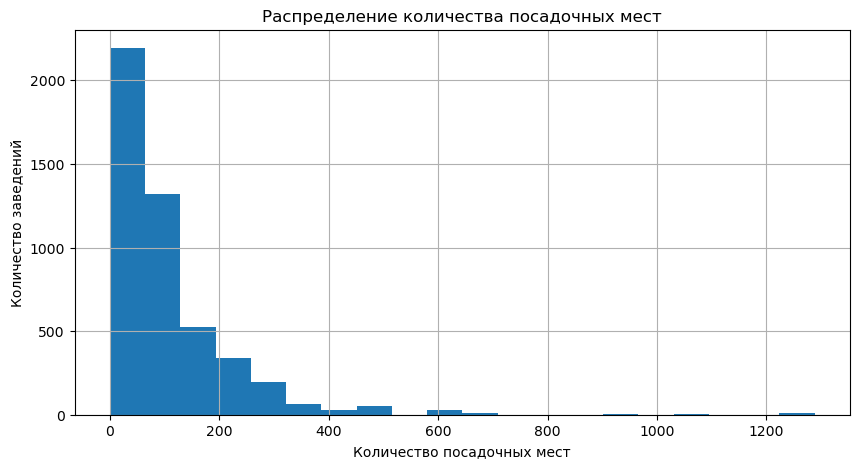

In [23]:
data['seats'].hist(bins=20, figsize=(10,5))
plt.title('Распределение количества посадочных мест')
plt.xlabel('Количество посадочных мест')
plt.ylabel('Количество заведений')
plt.show()

In [24]:
data['seats'].describe()

count    4769.000000
mean      108.277207
std       123.030008
min         0.000000
25%        40.000000
50%        75.000000
75%       140.000000
max      1288.000000
Name: seats, dtype: float64

Заведений с более 400 посадочных мест очень мало, а более 1000 посадочных мест могут похвастаться единицы (и то при условии, если это не ошибки). Заведения с 0 посадочных мест могут существовать (например, кофейни формата "кофе с собой").

Сделаем срез данных по значению 400. Предварительно подсчитаем потери.

In [25]:
print(f"Будет удалено {len(data[data['seats'] > 400])} строк, что составляет {round(100*len(data[data['seats'] > 400])/len(data), 2)}% данных.")
data = data.drop(data[data['seats'] > 400].index)
print(f"Строки с выборосами удалены. В таблице осталось {len(data)} строк.")

Будет удалено 121 строк, что составляет 1.45% данных.
Строки с выборосами удалены. В таблице осталось 8248 строк.


Рассмотрим распределение по очищенным данным.

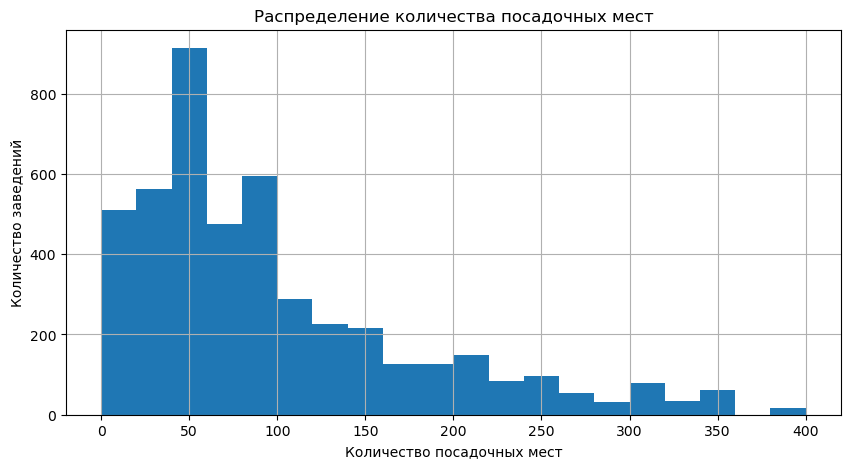

In [26]:
data['seats'].hist(bins=20, figsize=(10,5))
plt.title('Распределение количества посадочных мест')
plt.xlabel('Количество посадочных мест')
plt.ylabel('Количество заведений')
plt.show()

В таблице осталось некоторое количество заведений с большим количеством посадочных мест, явные аномалии устранены.

#### Столбец `chain`

По условиям задачи нам известно, что в столбце могут содержаться ошибки в данных о небольших сетях. Попробум их устранить. Для этого сгруппируем данные по наименованию, посчитаем количество заведений с одни и тем же наименованием, а также сумму значений в столбце `chain`. Так как признак сетевое/несетевое представлен в виде 0 и 1, у сетевых заведений с корректно отображенными данными сумма заведений и сумма в столбце `chain` должна совпасть. Рассматривать будем несовпадающие значения.

In [27]:
# формируем вспомогательную таблицу chains
chains = data.groupby('name').agg(count_all=('name','count'), chain=('chain','sum')).reset_index().sort_values(by='count_all', ascending=False)

In [28]:
# выбираем заведения, которые отмечены как несетевые, но их наименования встречаются более одного раза
chains.query('count_all > 1 and chain == 0')

,name,count_all,chain
2830,Кафе,188,0
5323,Шаурма,43,0
4172,Ресторан,33,0
4563,Столовая,28,0
3163,Кофейня,12,0
1980,Бистро,12,0
2979,Кафе-столовая,9,0
2069,Буфет,8,0
4748,Трапезная,7,0
5380,Шашлычная,6,0


Несетевые заведения с повторяющимися названиями имеют родовые наименования (кафе, ресторан и т.д.). Таких заведений достаточно много, и точного понимания того, что это за заведения, действуют они до сих пор или закрыты, у нас нет. Так как они помечены как несетевые, эти данные не внесут искажения в анализ самых популярных сетей (например, сеть "Кафе" могла бы оказаться одно из самых популярных), поэтому оставим эти данные без изменения.

In [29]:
# выбираем заведения, которые отмечены как сетевые, но их наименования встречаются только один раз
chains.query('count_all == chain and count_all == 1')

,name,count_all,chain
3645,Мюнгер,1,1
3653,Мясо на углях,1,1
3691,Нам,1,1
3933,Пивбар,1,1
3989,Пицца экспресс,1,1
...,...,...,...
2093,Бюро Пиццы,1,1
2184,Виолино,1,1
1896,Бакинский дворик,1,1
1918,Барбарис,1,1


Сетей, состоящих из 1 заведения, в таблице 77. Возможно, какие-то из этих заведений и являются сетевыми, просто сеть слишком маленькая, и в Москве открыто всего одно заведение сети. Однако даже в таком случае в рамках Москвы заведение сетевым не является. Заменим значение 1 в таких стобцах на 0.

In [30]:
for loc in chains.query('count_all == chain and count_all == 1')['name'].unique():
    try:
        data.loc[data['name'] == loc, 'chain'] = 0
    except:
        continue

#### Данные после предобработки

In [31]:
data.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN,улица Дыбенко,False
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0,улица Дыбенко,False
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0,Клязьминская улица,False
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN,улица Маршала Федоренко,False
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0,Правобережная улица,False


In [32]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 8248 entries, 0 to 8405
Data columns (total 16 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8248 non-null   object 
 1   category           8248 non-null   object 
 2   address            8248 non-null   object 
 3   district           8248 non-null   object 
 4   hours              7724 non-null   object 
 5   lat                8248 non-null   float64
 6   lng                8248 non-null   float64
 7   rating             8248 non-null   float64
 8   price              3228 non-null   object 
 9   avg_bill           3718 non-null   object 
 10  middle_avg_bill    3064 non-null   float64
 11  middle_coffee_cup  522 non-null    float64
 12  chain              8248 non-null   int64  
 13  seats              4648 non-null   float64
 14  street             8248 non-null   object 
 15  is_24/7            8248 non-null   bool   
dtypes: bool(1), float64(6), 

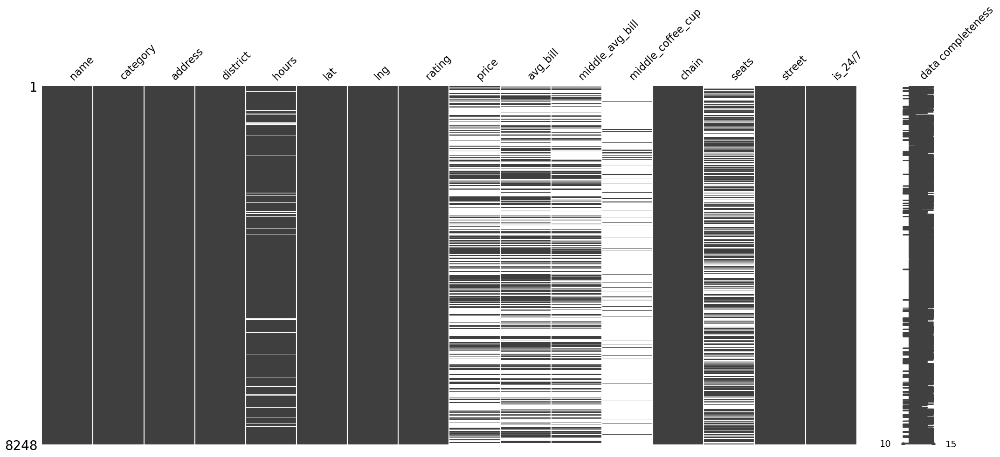

In [33]:
# визуализация пропусков после обработки данных
msno.matrix(data, labels=True)
None

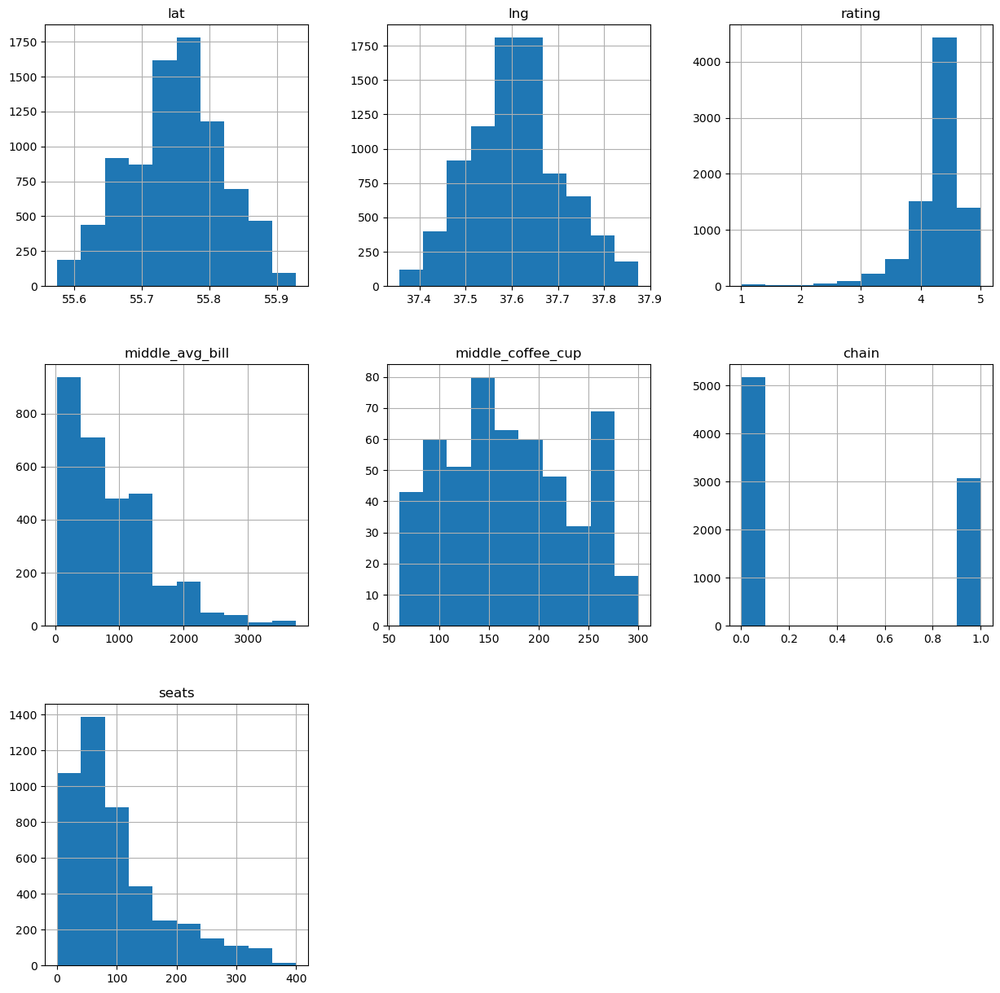

In [34]:
# распределение данных в таблице после обработки
data.hist(figsize=(15, 15))
None

##### Результаты предобработки:
- удалены 158 строк (1,88% от исходных данных) с выбросами в столбцах `middle_avg_bill`, `middle_coffee_cup`, `seats`
- пропуски в столбце `hours` заполнены модальными значениями часов работы заведений из той же категории, расположенных в тех же самых районах
- добавлены столбцы `is_24/7` с признаком круглосуточной работы и `street` с наименованием улицы
- за счет заполнения пропусков и удаления выбросов данные стали более плотными, увеличилась равномерность их распределения


## Анализ данных

В данном разделе последовательно ответим на поставленные в задании вопросы.

### Категории заведений

*Какие категории заведений представлены в данных? Исследуйте количество объектов общественного питания по категориям: рестораны, кофейни, пиццерии, бары и так далее. Постройте визуализации. Ответьте на вопрос о распределении заведений по категориям.*

In [35]:
fig = px.bar(data.groupby('category').agg({'name':'count'}).reset_index().sort_values(by='name', ascending=False), x='category', y='name', text='name', labels={'name': 'Количество сетевых заведений', 'category': 'Категория заведения'}, title='Количество заведений общественного питания различных категорий')
fig.show()

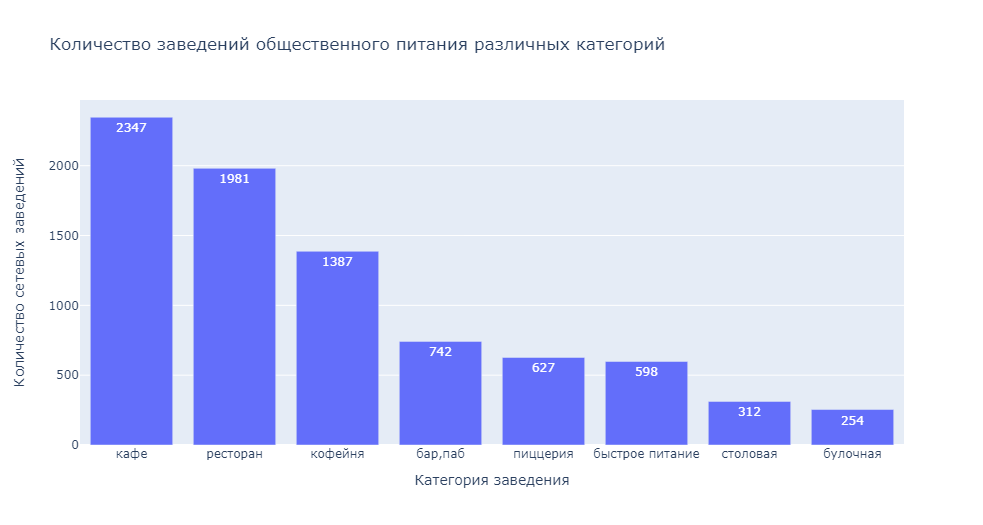

В таблице представлены 8 категорий заведений:
- кафе
- ресторан
- кофейня
- бар, паб
- пиццерия
- быстрое питание
- столовая
- булочная

Самая многочисленная категория (2347 заведений, 28,5%) - кафе.
Самая малочисленная (254 заведения, 3,08%) - булочная.

### Количество посадочных мест

*Исследуйте количество посадочных мест в местах по категориям: рестораны, кофейни, пиццерии, бары и так далее. Постройте визуализации. Проанализируйте результаты и сделайте выводы.*

Посчитаем медианное количество посадочных мест в каждой категории.

In [36]:
fig = px.bar(data.groupby('category').agg({'seats':'median'}).reset_index().sort_values(by='seats', ascending=False), x='category', y='seats', text='seats', labels={'seats': 'Медианное количество посадочных мест', 'category': 'Категория заведения'}, title='Распределение медианного количества посадочных мест по категориям')
fig.show()

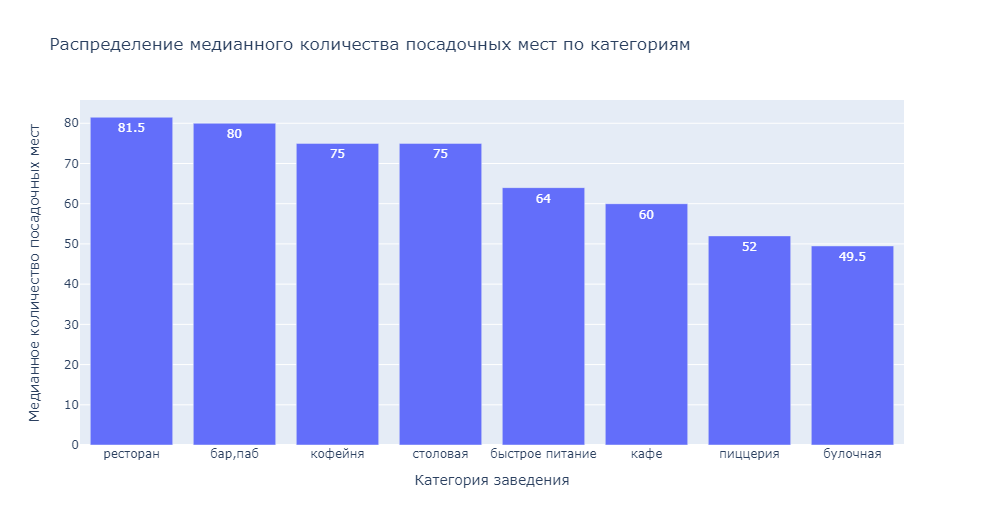

Больше всего посадочных мест бывает в ресторанах - медианное количество 85. Меньше всего - в булочных.

Посчитаем, какие минимальные и максимальные значения количества посадочных мест встречаются в заведениях разных категорий.

In [37]:
data.groupby('category').agg({'seats':['min', 'max', 'median']}).reset_index()

category seats              
                     min    max median
0          бар,паб   0.0  400.0   80.0
1         булочная   0.0  320.0   49.5
2  быстрое питание   0.0  350.0   64.0
3             кафе   0.0  400.0   60.0
4          кофейня   0.0  400.0   75.0
5         пиццерия   0.0  400.0   52.0
6         ресторан   0.0  400.0   81.5
7         столовая   0.0  350.0   75.0

В каждой категории есть заведения как с очень большим количеством посадочных мест, так и без посадочных мест вообще. Составим функцию, которая распределит заведения по категориям в зависимости от количества посадочных мест, затем сгруппируем заведения по двум категориям и посчитаем их количество.

In [38]:
def seats_caregory(seats):
    if seats != seats:
        return 'без категории'
    if seats == 0:
        return '0: без посадочных мест'
    elif 0 < seats < 20:
        return '1-20: маленькое заведение'
    elif 21 < seats < 50:
        return '21-50: среднее заведение'
    elif 51 < seats < 100:
        return '51-100: большое заведение'
    elif seats > 100:
        return '> 100: очень большое заведение'

In [39]:
data['seats_category'] = data['seats'].apply(seats_caregory)

In [40]:
# подготовка данных
seats_by_category = data.query('seats_category != "без категории"').groupby(['seats_category', 'category']).agg({'name':'count'}).reset_index()
for loc in seats_by_category['category'].unique():
    seats_by_category.loc[seats_by_category['category'] == loc, 'total'] = (seats_by_category.loc[(seats_by_category['category'] == loc), 'name']).sum()

In [41]:
fig = px.bar(seats_by_category.sort_values(by=['total', 'category'], ascending=False), x='category', y='name', color='seats_category', barmode='group', labels={'name': 'Количество заведений', 'category': 'Категория заведения', 'seats_category': 'Категория по количеству посадочных мест'}, title='Количество заведений различного типа в завивимости от количества посадочных мест')
fig.show()

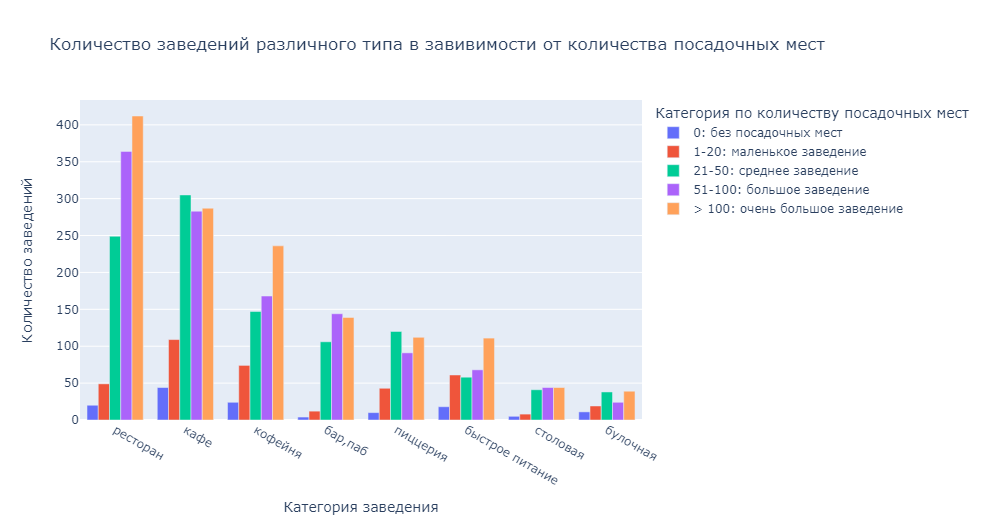

В категориях "большое заведение" и "очень большое заведение" лидируют рестораны. Средних, маленьких и заведений без посадочных мест больше всего среди кафе.

Отметим, что баров, пабов и столовых без посадочных мест в таблице очень мало, что объясняется самим форматом таких заведений.

### Сетевые vs несетевые заведения

#### Задание 1. Соотношение
*Рассмотрите и изобразите соотношение сетевых и несетевых заведений в датасете. Каких заведений больше?*

Сетевых заведений в таблице: 3070. Их доля составляет 37.22% от общего количества заведений в таблице.
Несетевых заведений в таблице: 5178. Их доля составляет 62.78% от общего количества заведений в таблице.


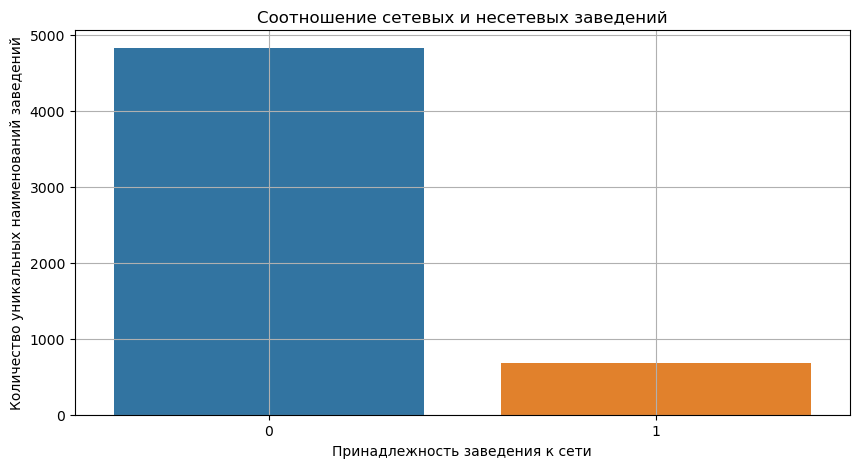

In [42]:
print(f"Сетевых заведений в таблице: {data.query('chain == 1')['name'].count()}. Их доля составляет {round(100*data.query('chain == 1')['name'].count()/data['name'].count(), 2)}% от общего количества заведений в таблице.")
print(f"Несетевых заведений в таблице: {data.query('chain == 0')['name'].count()}. Их доля составляет {round(100*data.query('chain == 0')['name'].count()/data['name'].count(), 2)}% от общего количества заведений в таблице.")

plt.figure(figsize=(10, 5))
ax = sns.barplot(x='chain', y='name', data=data.groupby('chain').agg({'name':'nunique'}).reset_index())
plt.title('Соотношение сетевых и несетевых заведений')
plt.xlabel('Принадлежность заведения к сети')
plt.ylabel('Количество уникальных наименований заведений')
plt.grid()
plt.show()

Несетевых заведений в таблице представлено гораздо больше, чем сетевых.

#### Задание 2. Категории

*Какие категории заведений чаще являются сетевыми? Исследуйте данные и ответьте на вопрос графиком.*

In [43]:
# считаем количество сетевых заведений в каждой категории, рисуем график

fig = px.bar(data.query('chain == 1').groupby('category').agg({'name':'count'}).reset_index().sort_values(by='name', ascending=False), x='category', y='name', text='name', labels={'name': 'Количество сетевых заведений', 'category': 'Категория заведения'}, title='Распределение количества сетевых заведений по категориям')
fig.show()

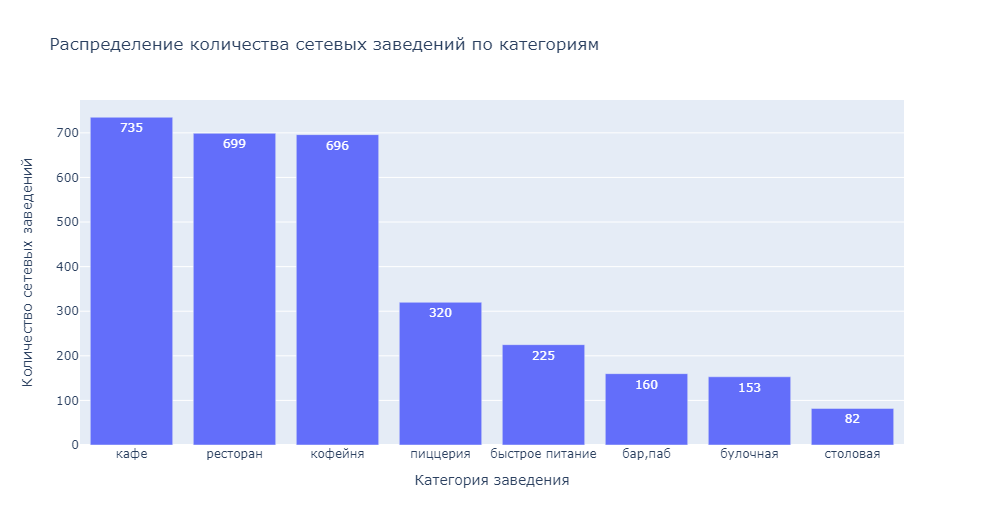

В абсолютных цифрах среди сетевых заведений больше всего кафе. Однако кафе в таблице больше всего по количеству, поэтому будет неправильно утверждать, что они чаще других являются сетевыми. Посчитаем долю сетевых заведений среди всех заведений той же категории.

In [44]:
# считаем количество сетевых заведений в каждой категории
chains = data.query('chain == 1').groupby('category').agg({'name':'count'}).reset_index().sort_values(by='category')

# добавляем в таблицу количество уникальных заведений в каждой категории (сетевых + несетевых)
chains['all'] = data.groupby('category').agg(total=('name','count')).reset_index().sort_values(by='category')['total']

# считаем долю сетевых заведений 
chains['rate2total'] = round(chains['name'] / chains['all'],2)

In [45]:
fig = px.bar(chains.sort_values(by='rate2total', ascending=False), x='category', y='rate2total', text='rate2total', labels={'rate2total': 'Доля сетевых заведений', 'category': 'Категория заведения'}, title='Доля сетевых заведений от всех заведений в категории')
fig.show()

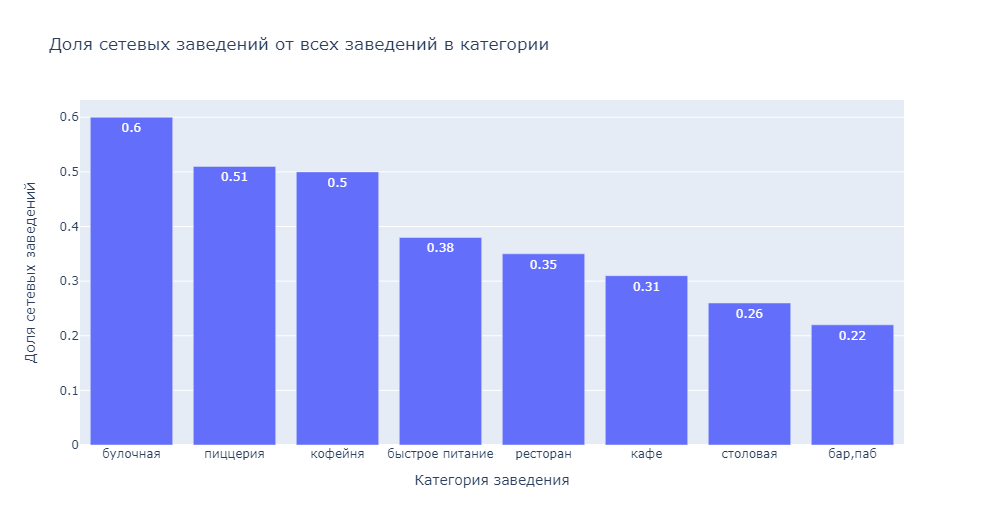

В относительных цифрах чаще всего сетевыми являются булочные, пиццерии и кофейни - доля сетевых заведений в этих категориях не ниже 50%. Реже всего сетевыми бывают бары и пабы.

#### Задание 3. Топ-15 сетей

*Сгруппируйте данные по названиям заведений и найдите топ-15 популярных сетей в Москве. Под популярностью понимается количество заведений этой сети в регионе. Постройте подходящую для такой информации визуализацию. Знакомы ли вам эти сети? Есть ли какой-то признак, который их объединяет? К какой категории заведений они относятся?*

In [46]:
# готовим данные для визуализации
top15 = data.query('chain == 1').groupby('name').agg(count=('name', 'count')).reset_index().sort_values(by='count', ascending=False).head(15)

In [47]:
# строим график
fig = px.bar(top15, x='name', y='count', text='count', labels={'name': 'Наименование сети', 'count': 'Количество заведений в сети'}, title='Топ-15 сетей по количеству заведений')
fig.show()

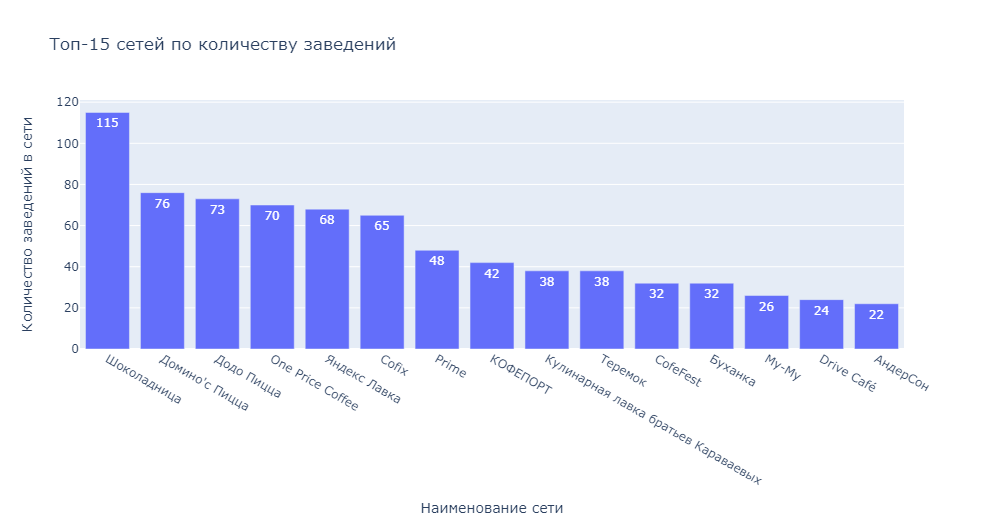

Некоторые из этих сетей известны и за пределами Москвы (например, Шоколадница, Додо Пицца, Cofix).

По поводу Хинкальной и Чайханы есть некоторые сомнения. Полагаем, что как и в случае с кафе "Кафе" не все эти хинкальные и чайханы могут принадлежать одной сети и, скорее всего, являются родовым наименованием. Попробуем переопределить топ-15, исключив из него эти наименования.

In [48]:
top15 = data.query('chain == 1 and name != "Хинкальная" and name != "Чайхана"').groupby('name').agg(count=('name', 'count')).reset_index().sort_values(by='count', ascending=False).head(15)
# строим график
fig = px.bar(top15, x='name', y='count', text='count', labels={'name': 'Наименование сети', 'count': 'Количество заведений в сети'}, title='Топ-15 сетей по количеству заведений')
fig.show()

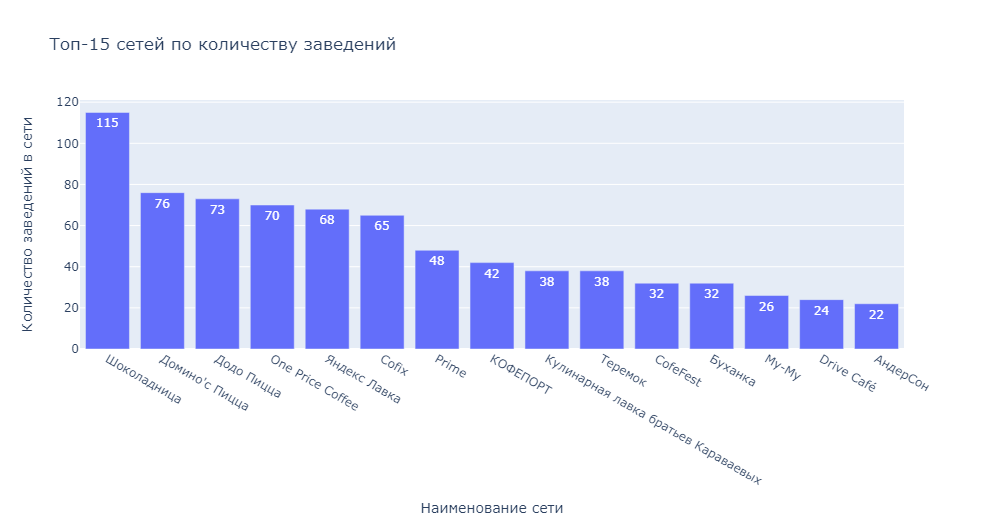

После удаления сомнительных названий топ-15 добавил две новые сети.

Если судить по названиям, большинство заведений из топ-15 тем или иным образом связаны с кофе. Исследуем категории, к которым относятся заведения из топ-15. Предполагаем, что среди заведений одной и той же сети могут встречаться заведения разных форматов.

In [49]:
top15cat = data.query('name in @top15.name').groupby(['name', 'category']).agg(places=('name','count')).reset_index()
top15cat

,name,category,places
0,CofeFest,кафе,1
1,CofeFest,кофейня,31
2,Cofix,кофейня,65
3,Drive Café,кафе,24
4,One Price Coffee,кофейня,70
5,Prime,кафе,1
6,Prime,ресторан,47
7,АндерСон,кафе,17
8,АндерСон,кофейня,1
9,АндерСон,ресторан,4


Из полученной таблицы видно, что в некоторых сетях есть заведения разных категорий (а сеть "Му-Му" включает заведения 7 типов). Это может отражать как реальную картину, так и являться следствием ошибки при внесении данных в сервисы.

Для анализа распределения заведений топ-15 сетей по категориям поступим следующим образом: оставим в таблице только те категории заведений, к которым относятся большинство заведений сети, и построим визуализацию на основании этих данных.

In [50]:
# соединяем таблицу с самой собой, предварительно сгруппировав ее по наименованию и выделив количество заведений в наиболее популярной категории, оставляем только те категории, к которым относятся заведения с максимальным количеством
top15cat = top15cat.merge(top15cat.groupby('name').agg({'places':'max'}).reset_index(), on=['name', 'places'], how='right')

In [51]:
# строим график

fig = px.bar(top15cat.sort_values(by='places', ascending=False), x='category', y='places', text='places', color='name', width=1000, height=800, color_discrete_sequence=px.colors.qualitative.Dark24, labels={'places': 'Количество заведений', 'category': 'Категория заведения'}, title='Распределение заведений из топ-15 по категориям')
fig.show()

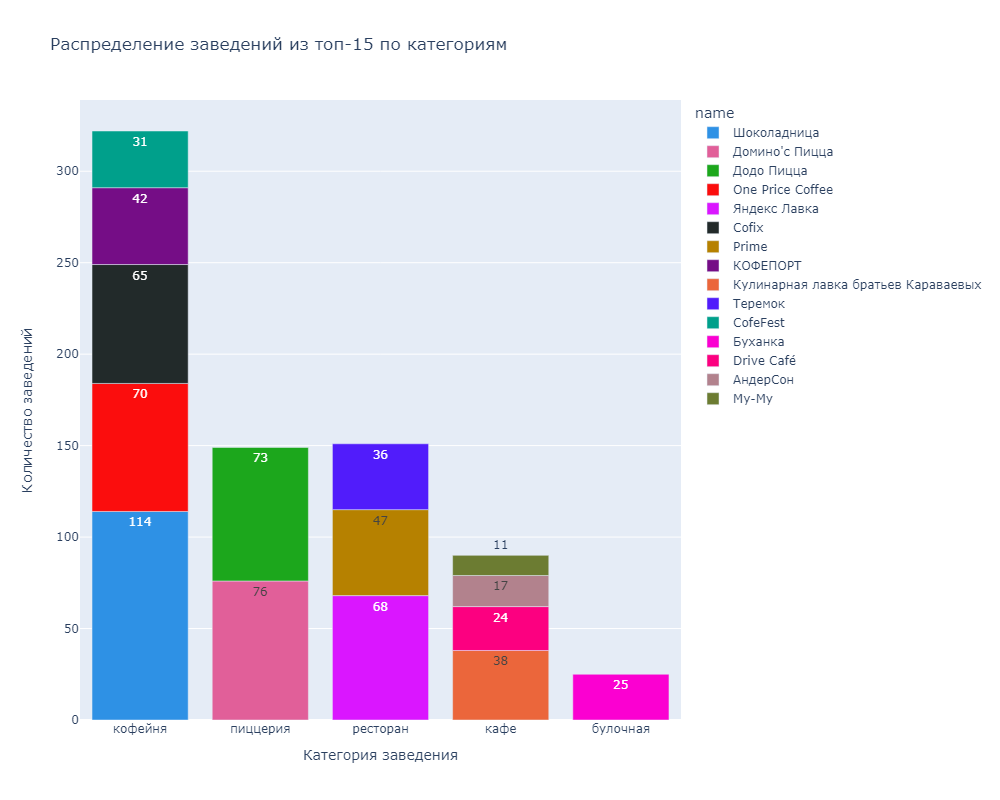

В топ-15 представлены заведения из следующих категорий:
- кофейня
- пиццерия
- ресторан
- кафе
- булочная

По количеству больше всего в Москве сетевых кофеен (лидер в Сегменте - Шоколадница).

### Распределение по районам

*Какие административные районы Москвы присутствуют в датасете? Отобразите общее количество заведений и количество заведений каждой категории по районам. Попробуйте проиллюстрировать эту информацию одним графиком.*

In [52]:
# подготовка данных
distr = data.groupby(['district', 'category']).agg({'name':'count'}).reset_index()
for loc in distr['district'].unique():
    distr.loc[distr['district'] == loc, 'total'] = (distr.loc[(distr['district'] == loc), 'name']).sum()

In [53]:
fig = px.bar(distr.sort_values(by=['total','district'], ascending=False), x='district', y='name', text='name', color='category', height=1000, barmode='stack', labels={'name': 'Количество заведений', 'category': 'Категория заведения', 'district': 'Административный район'}, title='Распределение заведений по административным районам')
fig.show()

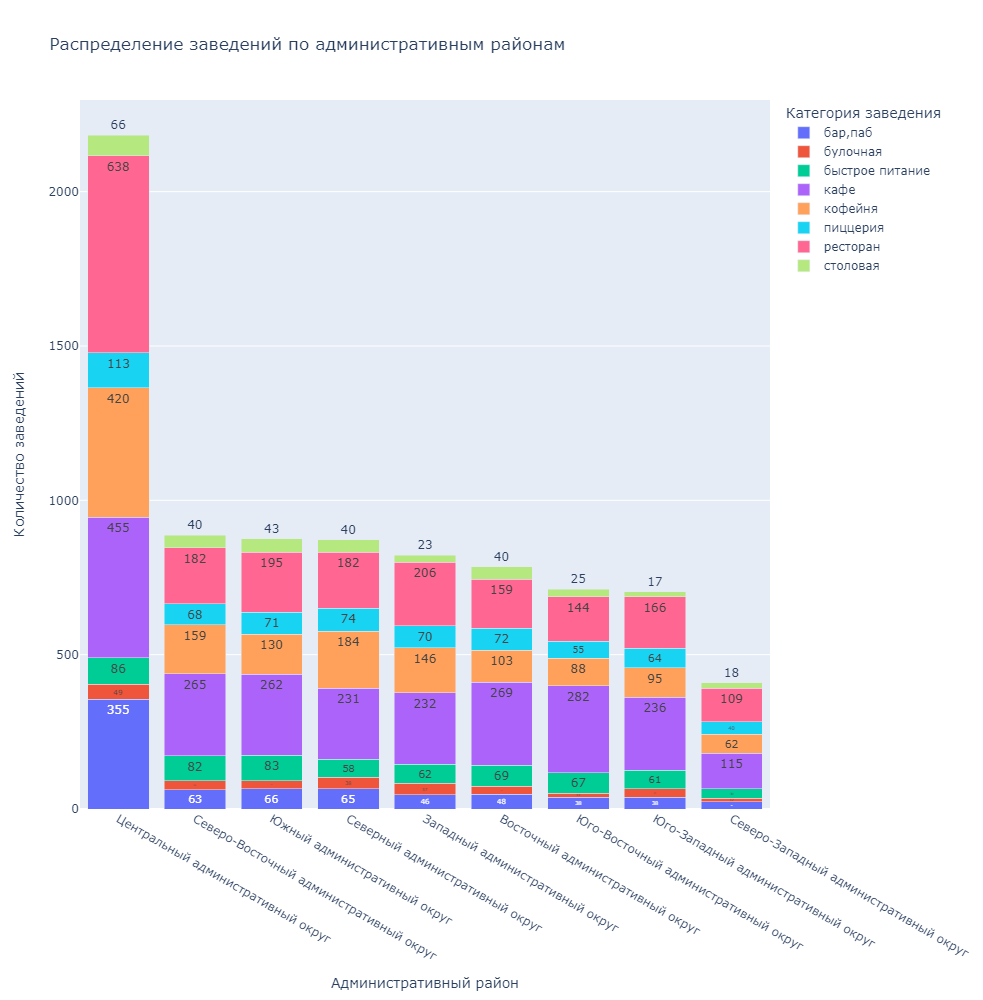

В таблице присутствуют данные о заведениях, расположенных на территории 9 административных районов Москвы. Больше всего заведений (более 2000) расположено в Центральном административном округе. Наиболее популярны в нем рестораны.

### Средние рейтинги

#### Задание 1. Визуализация средних рейтингов

*Визуализируйте распределение средних рейтингов по категориям заведений. Сильно ли различаются усреднённые рейтинги в разных типах общепита?*

In [54]:
print(f"Средний рейтинг по всей таблице: {round(data['rating'].mean(), 2)}")

Средний рейтинг по всей таблице: 4.23


In [55]:
# готовим данные для визуализации
ratings = data.groupby('category').agg({'rating':'mean'}).reset_index()
ratings['rating'] = round(ratings['rating'],2)

In [56]:
fig = px.bar(ratings.sort_values(by='rating', ascending=False), x='category', y='rating', text='rating', labels={'rating': 'Средний рейтинг категории', 'category': 'Категория заведения', 'district': 'Административный район'}, title='Средний рейтинг по категориям')
fig.show()

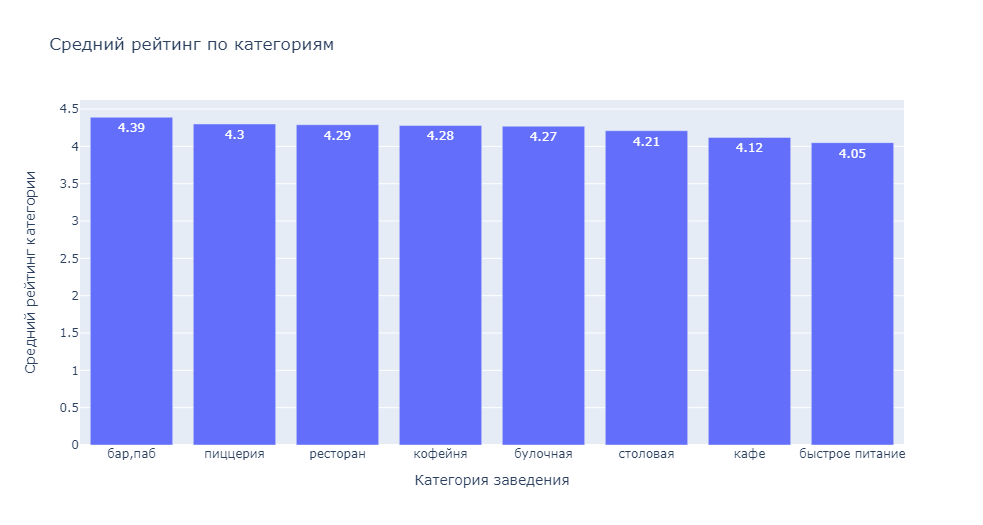

Средний рейтинг заведений в различных категориях варьируется от 4,39 (бар, паб) до 4,05 (быстрое питание). В большинстве категорий средний рейтинг очень близок к среднему по всей таблице - 4,23.

#### Задание 2. Рейтинги по районам

*Постройте фоновую картограмму (хороплет) со средним рейтингом заведений каждого района.*

In [57]:
# читаем файл с границами районов Москвы и сохраняем в переменной
with open('admin_level_geomap.geojson', 'r') as f:
    geo_json = json.load(f)

In [58]:
# строим фоновую картограмму

# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10, tiles='Cartodb Positron')

# создаём хороплет и добавляем его на карту
cp = Choropleth(
    geo_data=geo_json,
    data=data.groupby('district').agg({'rating':'mean'}).reset_index(),
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='Purples',
    fill_opacity=0.8,
    legend_name='Средний рейтинг заведений по районам',
).add_to(m)

# добавляем наименования районов в всплывающие подсказки
folium.GeoJsonTooltip(['name']).add_to(cp.geojson)
folium.LayerControl().add_to(m)

# выводим карту
m

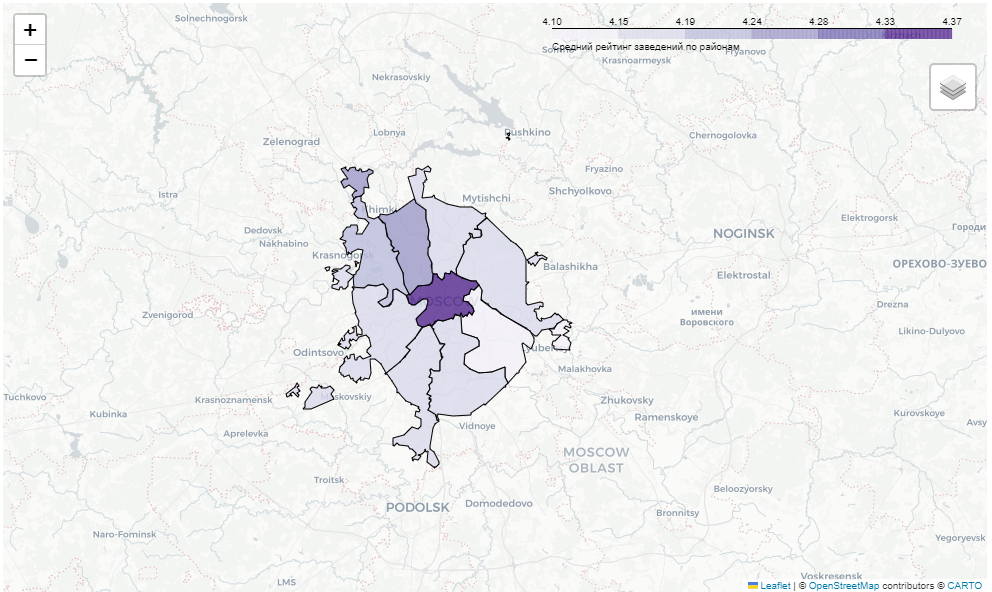

Средний рейтинг заведений в разных округах не одинаков. Самый высокий средний рейтинг у заведений, расположенных в ЦАО, самый низкий - у заведений в ЮВАО.

#### Определение зависимости между рейтингом и величиной среднего чека

Визуализируем взаимосвязь между рейтингом заведения и величиной среднего чека.

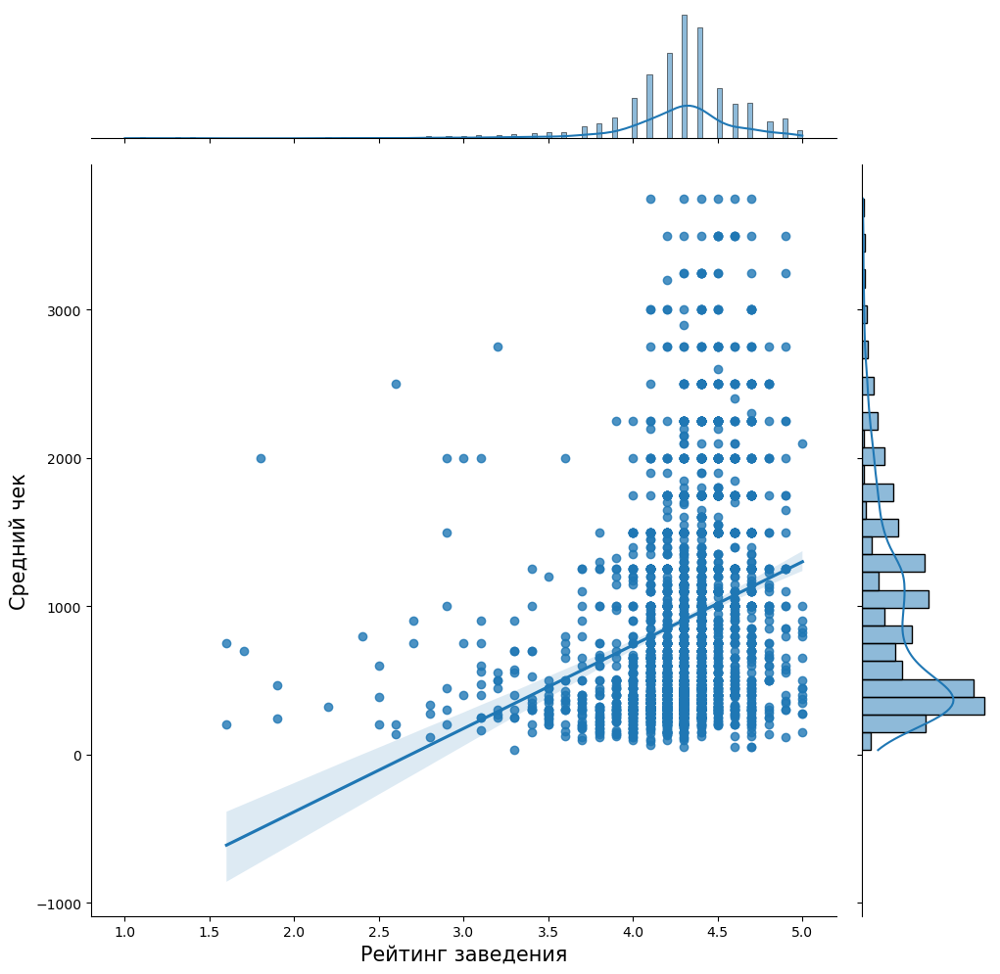

In [59]:
h = sns.jointplot(x='rating', y='middle_avg_bill', data=data, kind='reg', height=10) 
h.set_axis_labels('Рейтинг заведения', 'Средний чек', fontsize=15)
plt.show()

Данные показывают наличие положительной линейной зависимости: чем выше рейтинг заведения, тем больше сумма среднего чека.

### Расположение заведений на карте

*Отобразите все заведения датасета на карте с помощью кластеров средствами библиотеки folium.*

In [60]:
# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10, tiles='Cartodb Positron')

# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m)

# задаем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']}",
    ).add_to(marker_cluster)

# применяем функцию create_clusters() к каждой строке датафрейма
data.apply(create_clusters, axis=1)

# выводим карту
m

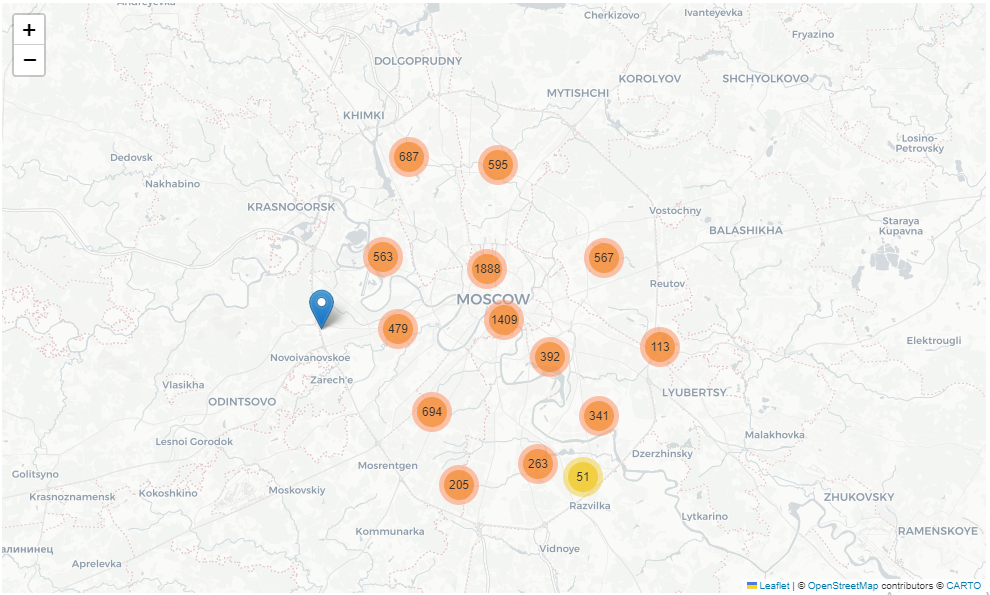

Чем ближе к центру города, тем крупнее кластеры.

### Улицы

#### Топ-15 улиц

*Найдите топ-15 улиц по количеству заведений. Постройте график распределения количества заведений и их категорий по этим улицам. Попробуйте проиллюстрировать эту информацию одним графиком.*

In [61]:
# группируем данные по названию улицы, считаем количество заведений на каждой, сортируем, выводим топ-15

top15streets = data.groupby('street').agg(count=('name', 'count')).reset_index().sort_values(by='count', ascending=False).head(15)
top15streets

,street,count
1086,проспект Мира,183
770,Профсоюзная улица,122
522,Ленинский проспект,101
1083,проспект Вернадского,97
370,Дмитровское шоссе,87
452,Каширское шоссе,76
296,Варшавское шоссе,76
520,Ленинградский проспект,71
521,Ленинградское шоссе,69
547,МКАД,65


Самая богатая на заведения улица Москвы - проспект Мира. На ней расположено 183 заведения общественного питания.

Отразим заведения, расположенные на этих улицах, на карте.

In [62]:
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10, tiles='Cartodb Positron')

# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его на карту
def create_marker(row):
    icon_url = 'https://img.icons8.com/?size=48&id=107458&format=png'
    icon = CustomIcon(icon_url, icon_size=(10, 10))
    Marker([row['lat'], row['lng']],
        popup=f"{row['name']}",
        icon=icon
    ).add_to(m)

# применяем функцию для создания маркера к записям датафрейма
data.query('street in @top15streets.street').apply(create_marker, axis=1)
    
# выводим карту
m

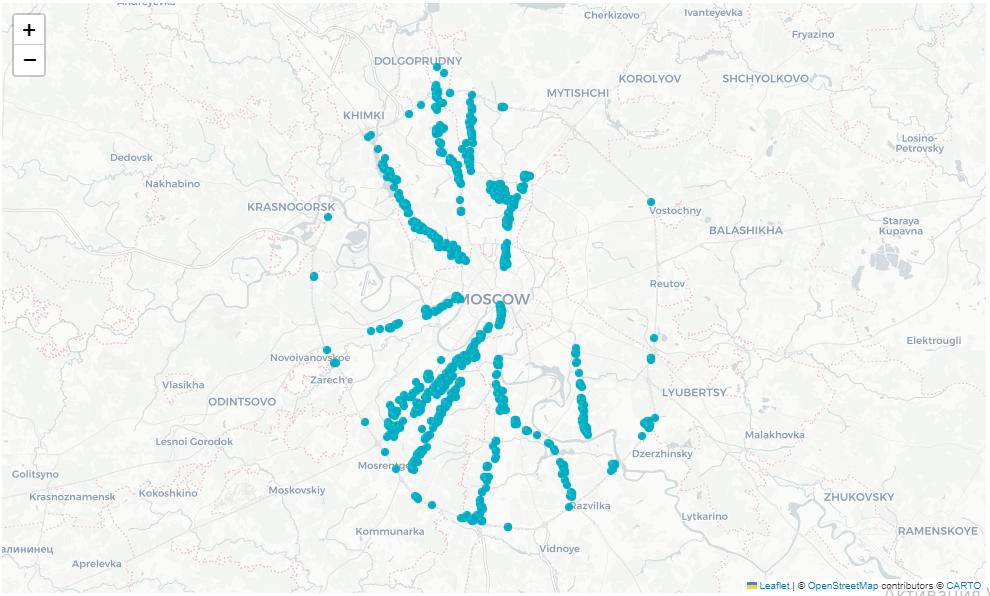

В основном такие улицы расположены в западных районах Москвы. В центре таких улиц мало.

Посмотрим, заведения каких категорий чаще всего встречаются на этих улицах.

In [63]:
# подготовка данных
strt = data.query('street in @top15streets.street').groupby(['street', 'category']).agg({'name':'count'}).reset_index()
for loc in strt['street'].unique():
    strt.loc[strt['street'] == loc, 'total'] = (strt.loc[(strt['street'] == loc), 'name']).sum()

In [64]:
fig = px.bar(strt.sort_values(by=['total','street'], ascending=False), x='street', y='name', color='category', barmode='group', labels={'name': 'Количество заведений', 'category': 'Категория заведения', 'street': 'Улица'}, title='Распределение заведений на 15 улицах с максимальным количеством заведений')
fig.show()


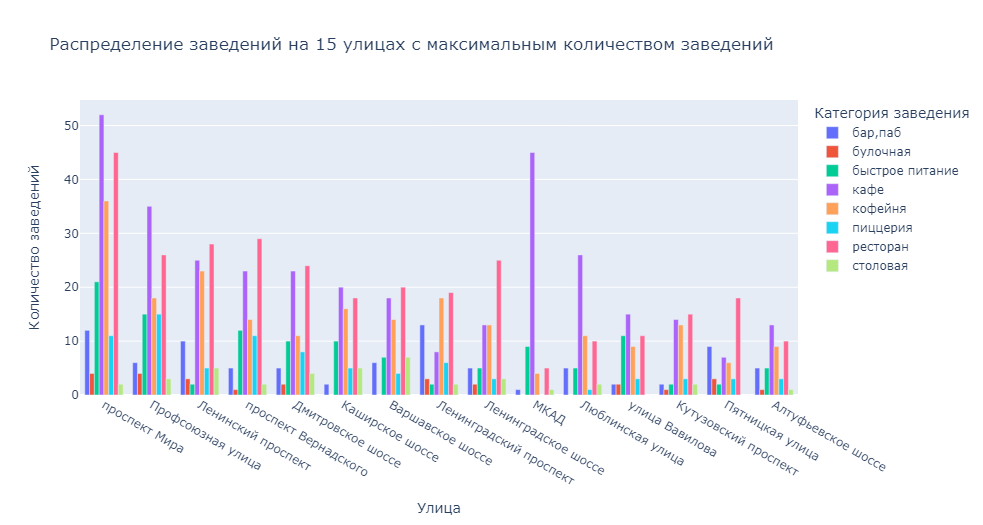

Три самых часто встречающихся категории заведений на проспекте Мира: кафе, ресторан, кофейня.

#### Улицы с одним заведением

*Найдите улицы, на которых находится только один объект общепита. Что можно сказать об этих заведениях?*

In [65]:
# выбираем улицы, на которых расположено всего одно заведение
one = data.groupby('street').agg(count=('name', 'count')).reset_index().query('count == 1')
one

,street,count
0,1-й Автозаводский проезд,1
1,1-й Балтийский переулок,1
2,1-й Варшавский проезд,1
3,1-й Вешняковский проезд,1
5,1-й Голутвинский переулок,1
...,...,...
1431,улица Шкулёва,1
1432,улица Шкулёва 4,1
1434,улица Шухова,1
1437,улица Юннатов,1


Всего улиц-одиночек 455.

Посмотрим на расположение таких заведений.

In [66]:
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10, tiles='Cartodb Positron')

def create_marker(row):
    icon_url = 'https://img.icons8.com/?size=48&id=107458&format=png'
    icon = CustomIcon(icon_url, icon_size=(10, 10))
    Marker([row['lat'], row['lng']],
        popup=f"{row['name']}",
        icon=icon
    ).add_to(m)

data.query('street in @one.street').apply(create_marker, axis=1)
    
m

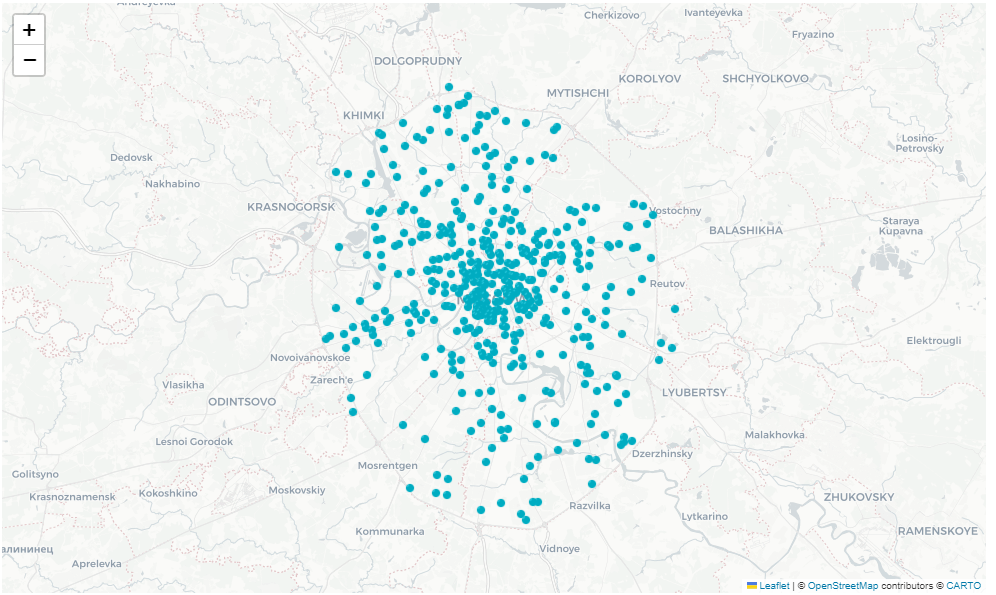

Больше всего таких заведений в центре Москвы. В остальных районах подобные заведения расположены более или менее равномерно.

Посчитаем, каких заведений больше всего на таких улицах.

In [67]:
fig = px.bar(data.query('street in @one.street').groupby('category').agg({'name':'count'}).reset_index().sort_values(by='name', ascending=False), x='category', y='name', text='name', labels={'name': 'Количество заведений', 'category': 'Категория заведения', 'district': 'Административный район'}, title='Количество заведений различных категорий')
fig.show()

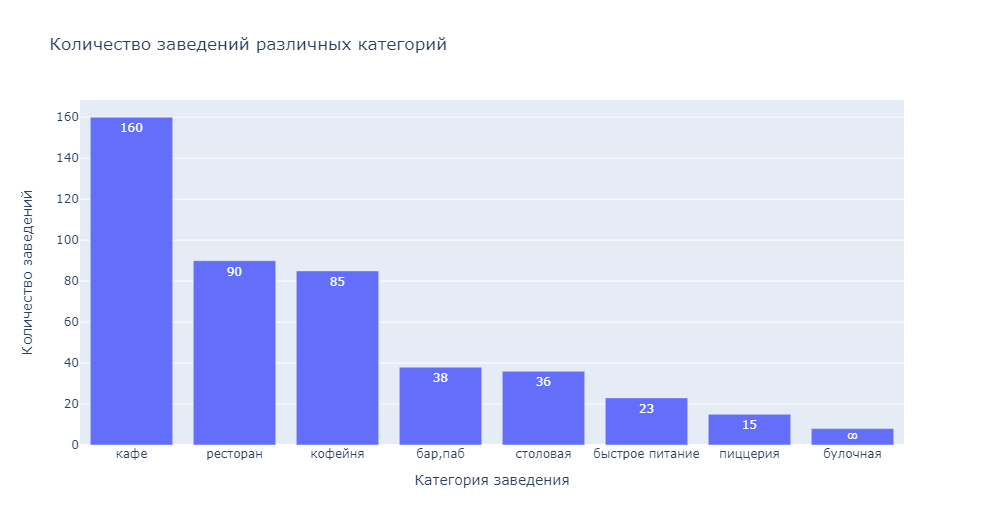

Как и в целом, чаще всего на улицах с одним заведением встречаются кафе.

Посчитаем средний рейтинг заведений.

In [68]:
# готовим данные для визуализации
oneratings = data.query('street in @one.street').groupby('category').agg({'rating':'mean'}).reset_index()
oneratings['rating'] = round(oneratings['rating'],2)

In [69]:
fig = px.bar(oneratings.sort_values(by='rating', ascending=False), x='category', y='rating', text='rating', labels={'rating': 'Средний рейтинг категории', 'category': 'Категория заведения'}, title='Средний рейтинг по категориям')
fig.show()

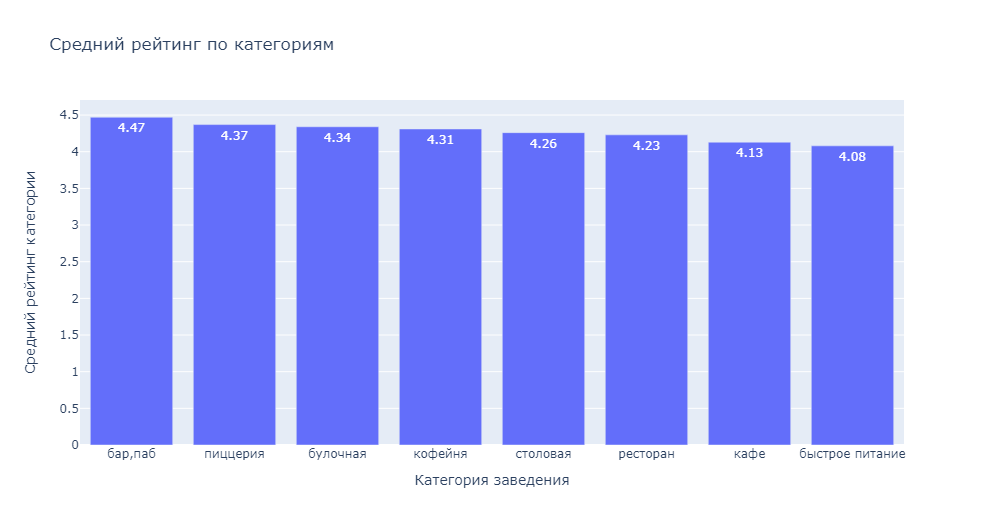!

Средние рейтинги заведений на улицах-одиночках не сильно отличаются от среднего рейтинга по всей таблице (4,23). Самые высокие рейтинги - у баров и пабов.

Посмотрим, заведения каких размеров наиболее популярны на улицах с одним заведением.

In [70]:
fig = px.bar(data.query('street in @one.street and seats_category != "без категории"').groupby('seats_category').agg({'name':'count'}).reset_index().sort_values(by='name', ascending=False), x='seats_category', y='name', text='name', labels={'seats_category': 'Категории в зависимости от количества мест', 'name': 'Количество заведений'}, title='Распределение заведений по категориям в зависимости от количества посадочных мест')
fig.show()

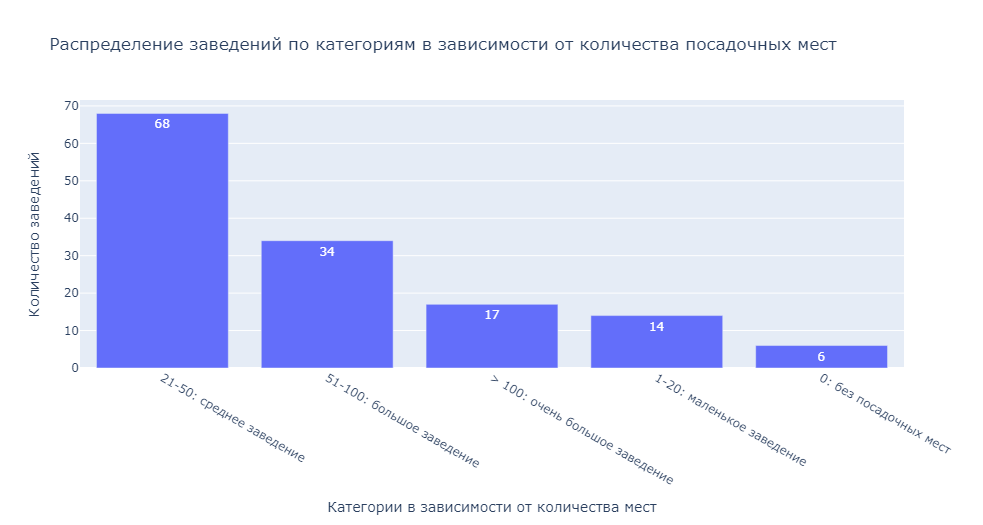

На улицах с одним заведением преобладают заведения среднего размера с количеством посадочных мест от 21 до 50.

In [71]:
fig = px.bar(data.query('street in @one.street').groupby('price').agg({'name':'count'}).reset_index().sort_values(by='name', ascending=False), x='price', y='name', text='name', labels={'price': 'Ценовая категория', 'name': 'Количество заведений'}, title='Распределение заведений по ценовым категориям')
fig.show()

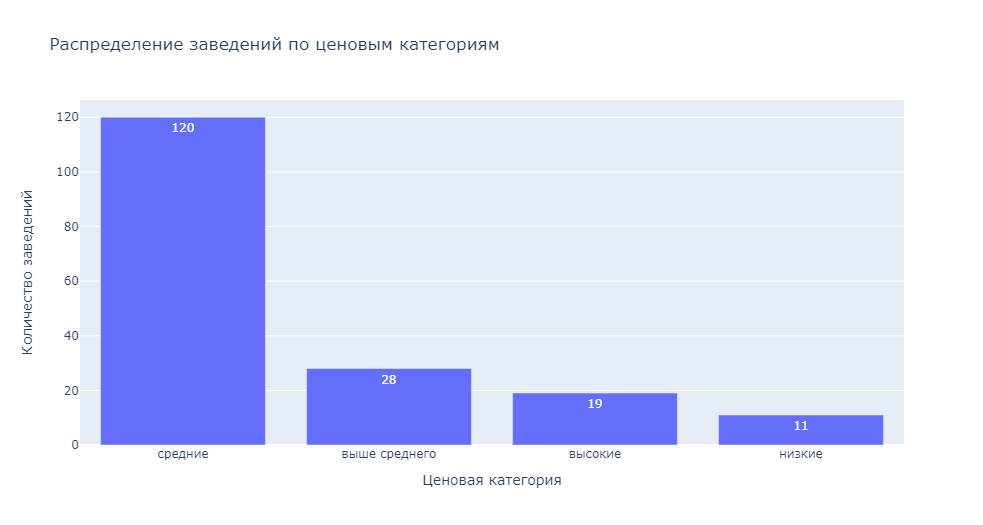

Подавляющее большинство заведений относятся к средней ценовой категории.

Таким образом, наиболее вероятный портрет единственного заведения на улице выглядит следующим образом: кафе средней ценовой категории на 20-50 человек, расположенное в центре Москвы, со средним рейтингом 4,1.

### Средние чеки

*Значения средних чеков заведений хранятся в столбце middle_avg_bill. Эти числа показывают примерную стоимость заказа в рублях, которая чаще всего выражена диапазоном. Посчитайте медиану этого столбца для каждого района. Используйте это значение в качестве ценового индикатора района. Постройте фоновую картограмму (хороплет) с полученными значениями для каждого района. Проанализируйте цены в центральном административном округе и других. Как удалённость от центра влияет на цены в заведениях?*

In [72]:
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10, tiles='Cartodb Positron')

cp = Choropleth(
    geo_data=geo_json,
    data=data.groupby('district').agg({'middle_avg_bill':'median'}).reset_index(),
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='Purples',
    fill_opacity=0.8,
    legend_name='Медианный чек по районам',
).add_to(m)

folium.GeoJsonTooltip(['name']).add_to(cp.geojson)
folium.LayerControl().add_to(m)

m

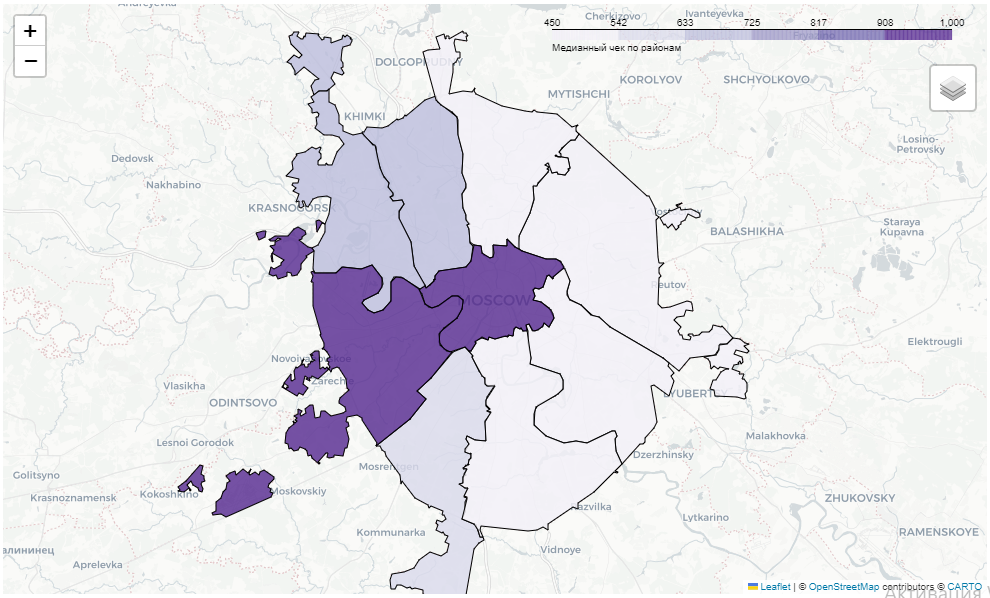

Самые высокие значения медианного чека отмечаются в ЦАО и ЗАО. Заметна следующая тенденция: чеки в заведениях, расположенных в западных районах Москвы, несколько выше, чем чеки заведений, расположенных в восточных районах.

### Общий вывод по разделу

Анализ рынка заведений общественного питания Москвы позволил выявить следующие закономерности:
1. На рынке представлены заведения из 8 категорий (по убыванию количества заведений):
    - кафе (2347 заведений, 28,5%)
    - ресторан
    - кофейня
    - бар, паб
    - пиццерия
    - быстрое питание
    - столовая
    - булочная (254 заведения, 3,08%)
2. Рестораны - категория заведений с самым большим медианным количеством посадочных мест. К этой же категории относится наибольшее количество заведений с количеством мест больше 50.
3. Сетевых заведений в таблице меньше, чем несетевых: 37,22% и 62,78% соответственно.
4. Булочные и фастфуды - две категории, доля сетевых заведений в которых превышает 25%. Реже всех сетевыми бывают бары/пабы.
5. Топ-15 сетей по количеству заведений:
    - Шоколадница
    - Домино'с Пицца
    - Додо Пицца
    - One Price Coffee
    - Яндекс Лавка
    - Cofix
    - Prime
    - КОФЕПОРТ
    - Кулинарная лавка братьев Караваевых
    - Теремок
    - CofeFest
    - Буханка
    - Му-Му
    - Drive Café
    - АндерСон
6. В топ-15 сетей представлены заведения следующих категорий: 
    - кофейня
    - пиццерия
    - ресторан
    - кафе (больше всего сетевых заведений в этой категории за счет лидера - сети "Шоколадница")
    - булочная
7. Наибольшее количество заведений общепита в Москве расположено в Центральном административном округе. Из них по количеству лидируют рестораны.
8. Средний рейтинг заведений в различных категориях варьируется от 4,39 (бар, паб) до 4,05 (быстрое питание). Средний рейтинг по всей таблице - 4,23.
9. Самый высокий срежний рейтинг у заведений, расположенных в Центральном административном округе, самый низкий - у заведений в Юго-Восточном.
10. Между рейтингом заведения и размером среднего чека наблюдается положительная линейная корреляция.
11. Самая богатая на заведения улица Москвы - проспект Мира. На ней расположено 183 заведения общественного питания.
12. На 455 улицах расположено всего по одному заведению общественного питания. Наибольшая концентрация таких удиц наблюдается в центре Москвы.
13. Самые высокие значения медианного чека отмечаются в Центральном административном округе и Западном административном округе.
14. Чеки в заведениях, расположенных в западных округах Москвы, несколько выше, чем чеки заведений, расположенных в восточных округах.

## Открытие кофейни

*Основателям фонда «Shut Up and Take My Money» не даёт покоя успех сериала «Друзья». Их мечта — открыть такую же крутую и доступную, как «Central Perk», кофейню в Москве. Будем считать, что заказчики не боятся конкуренции в этой сфере, ведь кофеен в больших городах уже достаточно. Попробуйте определить, осуществима ли мечта клиентов.*

Поиск ответа на вопрос клиентов начнем с анализа рынка кофеен Москвы.

### Анализ рынка кофеен Москвы

Для удобства дальнейшей работы выделим все кофейни в отдельную таблицу.

In [73]:
coffee = data.query('category == "кофейня"')

In [74]:
print(f"Всего кофеен в таблице: {len(coffee)}")

Всего кофеен в таблице: 1387


#### Расположение кофеен

##### Распределение по административным округам

In [75]:
fig = px.bar(coffee.groupby('district').agg({'name':'count'}).reset_index().sort_values(by='name', ascending=False), x='district', y='name', text='name', labels={'name': 'Количество кофеен', 'district': 'Административный округ'}, title='Распределение кофеен по административным округам')
fig.show()

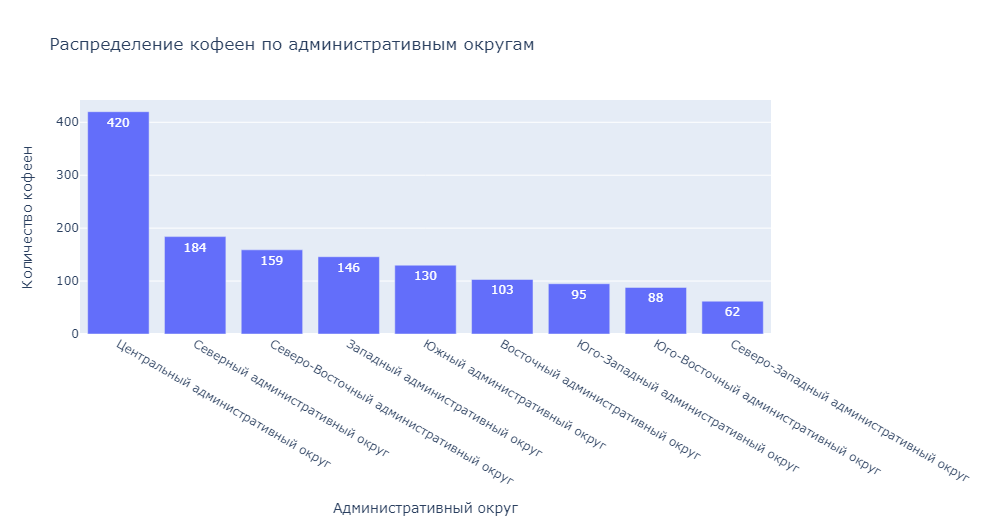

Больше всего кофеен ожидаемо расположено в ЦАО.

##### Топ-15 кофейных улиц

Выберем топ-15 улиц с самым большим количеством кофеен и укажем их на карте.

In [76]:
top15coffee = coffee.groupby('street').agg(count=('name', 'count')).reset_index().sort_values(by='count', ascending=False).head(15)
top15coffee

,street,count
475,проспект Мира,36
213,Ленинский проспект,23
211,Ленинградский проспект,18
330,Профсоюзная улица,18
177,Каширское шоссе,16
119,Варшавское шоссе,14
473,проспект Вернадского,14
212,Ленинградское шоссе,13
206,Кутузовский проспект,13
283,Новослободская улица,13


In [77]:
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10, tiles='Cartodb Positron')

def create_marker(row):
    icon_url = 'https://img.icons8.com/?size=48&id=107458&format=png'
    icon = CustomIcon(icon_url, icon_size=(10, 10))
    Marker([row['lat'], row['lng']],
        popup=f"{row['name']}",
        icon=icon
    ).add_to(m)

coffee.query('street in @top15coffee.street').apply(create_marker, axis=1)
     
m

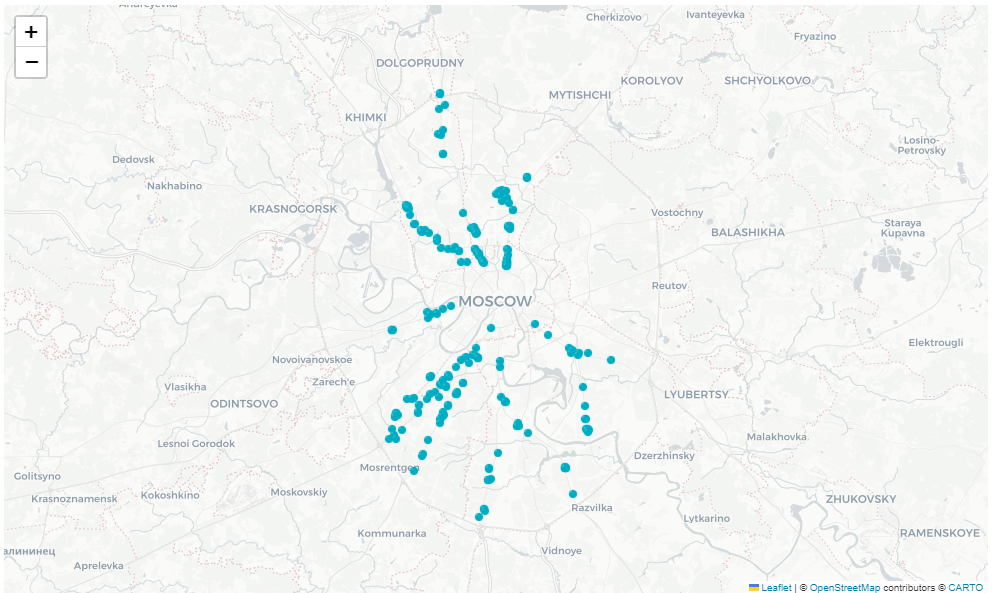

##### Улицы с одной кофейней

Выделим улицы, на которых расположена только одна кофейня.

In [78]:
onecoffee = coffee.groupby('street').agg(count=('name', 'count')).reset_index().query('count == 1')

m = Map(location=[moscow_lat, moscow_lng], zoom_start=10, tiles='Cartodb Positron')

def create_marker(row):
    icon_url = 'https://img.icons8.com/?size=48&id=107458&format=png'
    icon = CustomIcon(icon_url, icon_size=(10, 10))
    Marker([row['lat'], row['lng']],
        popup=f"{row['name']}",
        icon=icon
    ).add_to(m)

coffee.query('street in @onecoffee.street').apply(create_marker, axis=1)

m

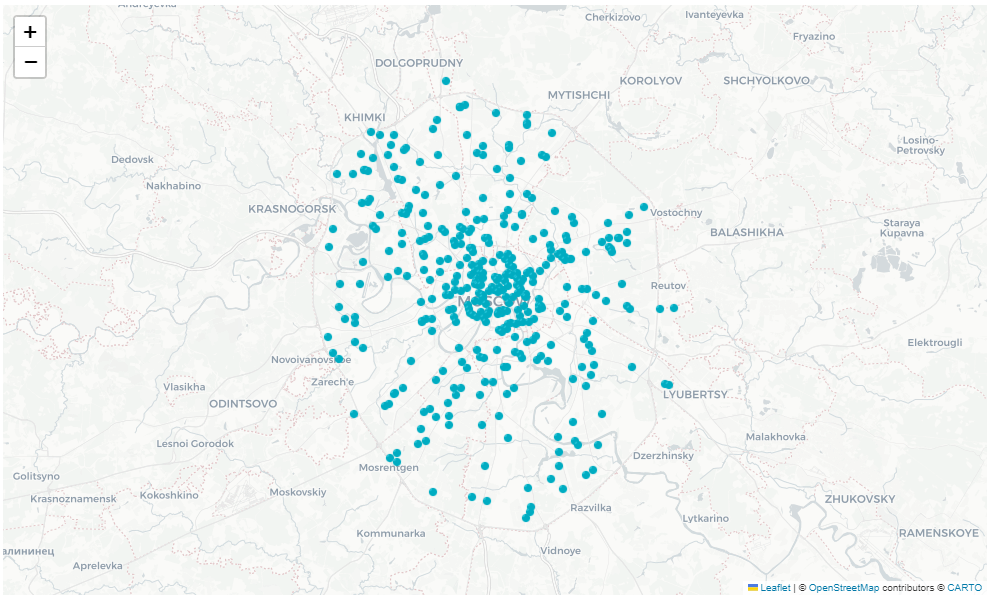

Распределение кофеен по улицам совпадает с общиим распределением заведений: улицы с самым большим количеством кофеен - длинные улицы, расходящиеся от центра к окраинам; больше всего улиц с одной кофеен расположено в центре Москвы.

#### Круглосуточные кофейни

Посчитаем количество круглосуточных кофеен и выясним, где они расположены.

In [79]:
print(f"Круглосуточных кофеен в Москве: {len(coffee[coffee['is_24/7'] == True])}")
print(f"Их доля от общего количества кофеен: {round(len(coffee[coffee['is_24/7'] == True])/len(coffee), 2)}%")

Круглосуточных кофеен в Москве: 58
Их доля от общего количества кофеен: 0.04%


In [80]:
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10, tiles='Cartodb Positron')

def create_marker(row):
    icon_url = 'https://img.icons8.com/?size=48&id=107458&format=png'
    icon = CustomIcon(icon_url, icon_size=(10, 10))
    Marker([row['lat'], row['lng']],
        popup=f"{row['name']}",
        icon=icon
    ).add_to(m)

coffee[coffee['is_24/7'] == True].apply(create_marker, axis=1)
    
m

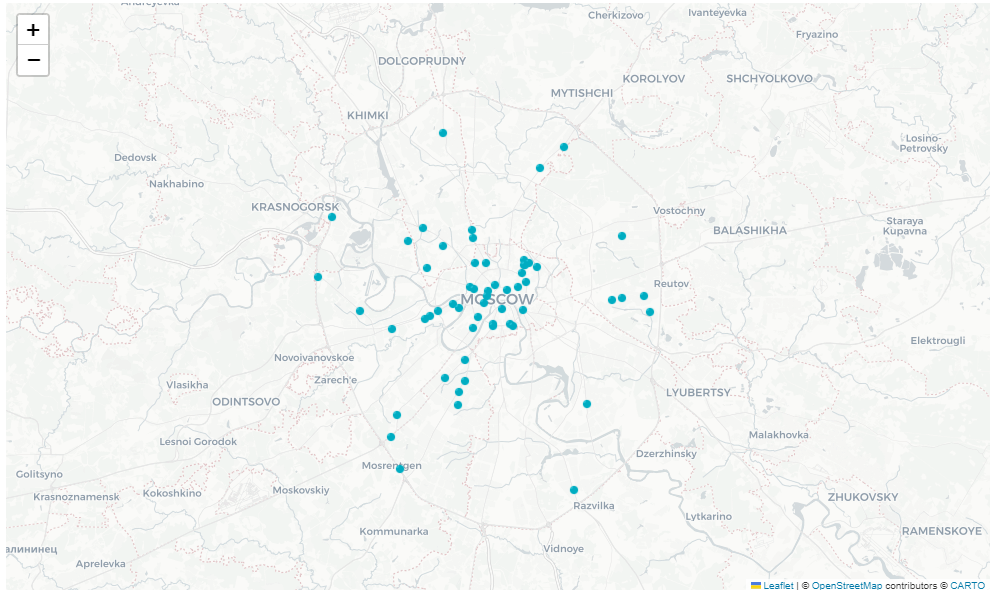

Круглосуточных кофеен немного, в основном они расположены в центре Москвы.

#### Рейтинг кофеен по районам

In [81]:
# строим фоновую картограмму

m = Map(location=[moscow_lat, moscow_lng], zoom_start=10, tiles='Cartodb Positron')

cp = Choropleth(
    geo_data=geo_json,
    data=coffee.groupby('district').agg({'rating':'mean'}).reset_index(),
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='Purples',
    fill_opacity=0.8,
    legend_name='Средний рейтинг кофеен по районам',
).add_to(m)

folium.GeoJsonTooltip(['name']).add_to(cp.geojson)
folium.LayerControl().add_to(m)

m

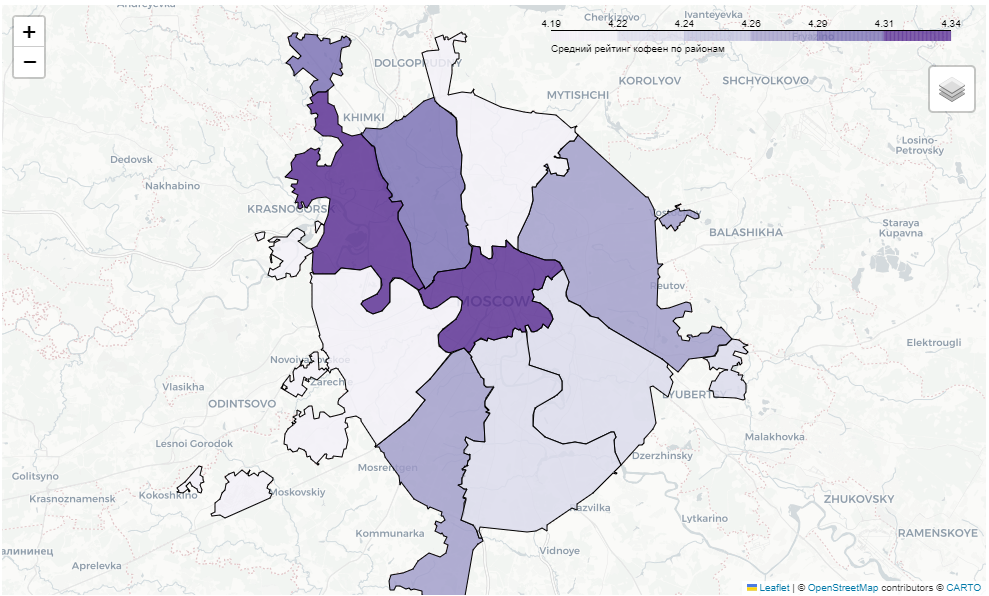

Кофейни с самым высоким средним рейтингом (4,31-4,34) расположены в ЦАО и СЗАО.

#### Стоимость чашки кофе

Сгруппируем данные по ценовым категориям и изучим медианную стоимость чашки кофе в каждой категории.

In [82]:
fig = px.bar(coffee.groupby('price').agg({'middle_coffee_cup':'median'}).reset_index().sort_values(by='middle_coffee_cup', ascending=False), x='price', y='middle_coffee_cup', labels={'middle_coffee_cup': 'Медианная стоимость чашки кофе', 'price': 'Ценовая категория'}, text='middle_coffee_cup', title='Медианная стоимость чашки кофе в зависимости от ценовой категории кофейни')
fig.show()

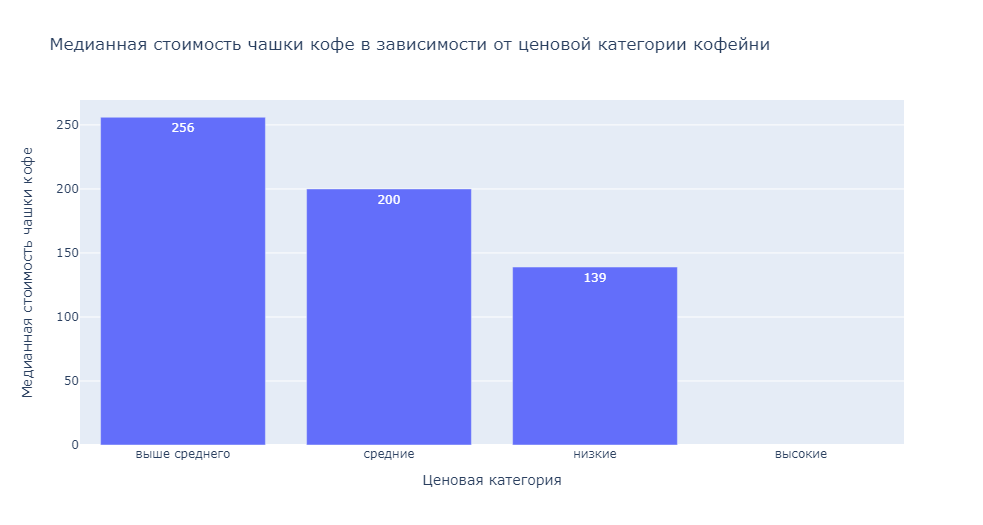

Средних цен для дорогих кофеен в таблице не оказалось. Медианная стоимость чашки кофе в кофейнях средней ценовой категории составляет 200 рублей, выше среднего - 256 рублей.

Определим наличие зависимости между рейтингом и средней стоимостью чашки кофе.

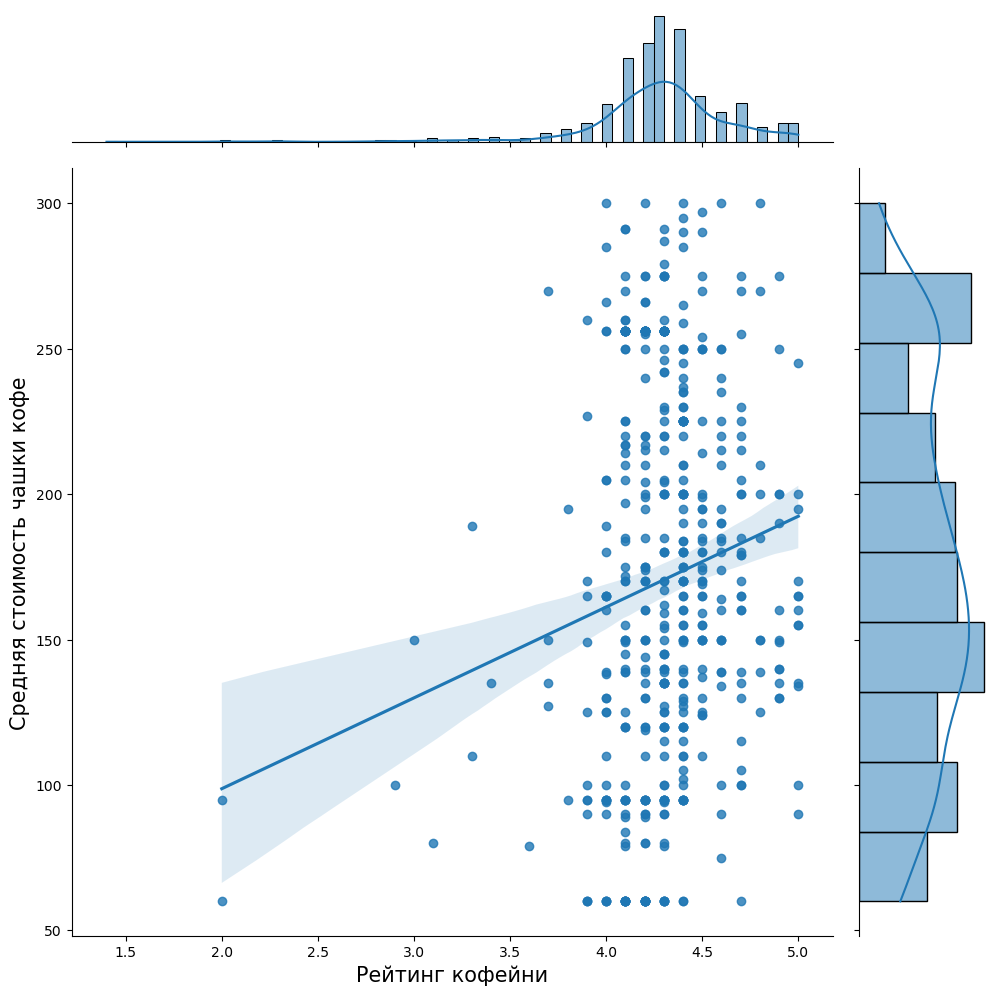

In [83]:
h = sns.jointplot(x='rating', y='middle_coffee_cup', data=coffee, kind='reg', height=10) 
h.set_axis_labels('Рейтинг кофейни', 'Средняя стоимость чашки кофе', fontsize=15)
plt.show()

Данных о кофейнях с низким рейтингом немного, но они, тем не менее, позволяют увидеть положительную линейную зависимость: чем выше рейтинг кофейни, тем дороже в ней чашка кофе.

#### Количество посадочных мест

Сгруппируем данные по категориям в зависимости от посадочных мест и посчитаем, сколько кофеен находится в каждой категории. Кроме того, посчитаем, сколько кофеен в каждой категории является сетевыми.

In [84]:
fig = px.bar(coffee.query('seats_category != "без категории"').groupby(['seats_category', 'chain']).agg({'name':'count'}).reset_index().sort_values(by='name', ascending=False), x='seats_category', y='name', color='chain', text='name', labels={'chain': 'Принадлежность к сети', 'seats_category': 'Категория в зависимости от количества посадочных мест', 'name': 'Количество кофеен'}, color_continuous_scale=px.colors.sequential.turbid, title='Распределение количества кофеен по категориям в зависимости от количества посадочных мест')
fig.show()

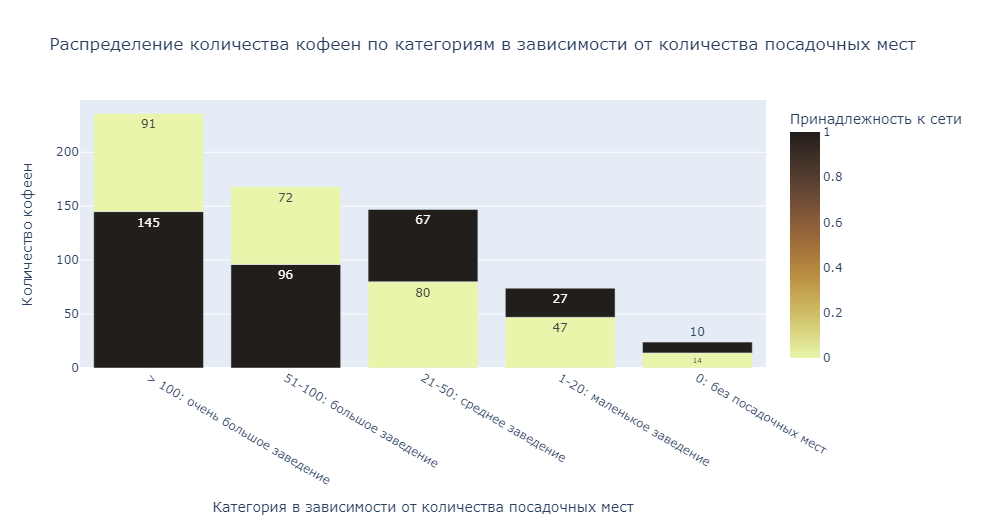

Больших кофеен с количеством посадочных мест больше 100 в таблице оказалось больше, чем каких-либо других. Сетевых кофеен в этой категории больше всего. Среди несетевых кофеен больших заведений также больше, чем каких-либо иных.

#### Резюме

Анализ рынка кофеен Москвы выявил следующие закономерности:
- больше всего кофеен расположено в Центральном админмстративном округе
- топ-15 улиц с самым большим количеством кофеен расположены на крупных улицах, идущих от центра к окраинам; в основном они расположены в западных районах
- большинство улиц с 1 кофейней расположены в центре Москвы
- круглосуточных кофеен в Москве всего 60 (0,04% от общего количества кофеен)
- кофейни с самым высоким средним рейтингом (4,31-4,34) расположены в Центральном и Северо-Западном административных округах
- медианная стоимость чашки кофе в кофейнях средней ценовой категории и категории выше среднего: 200 рублей и 256 рублей соответственно
- больше всего кофеен в таблице (из тех, для которых указана категория в зависисмости от посадочного места) - кофейни с количеством посадочных мест больше 100 (236 кофеен); 61,4% из них - сетевые

### Где открыть Cental Perk?

Теперь, когда мы имеем некоторое представление о рынке кофеен в Москве, можем приступить к разбору мечты заказчика. Выделим параметры, которые, на наш взгляд, соответствуют желаемому образу кофейни:
1. Location, location, location. Кофейня должна быть расположена в приятном спокойном месте. Чтобы она стала местом притяжения постоянных клиентов, желательно, чтобы поблизости не было расположено слишком много заведений такого же плана (или в принципе много заведений - торговый центр не подойдет). При этом место не должно быть где-то на отшибе - не хотелось бы, чтобы на соседних улицах располагались низкосортные забегаловки.
2. Кофейня не должна быть слишком большой. Оптимально - маленькое уютное заведение не более чем на 20 гостей.
3. Кофейня не должна быть слишком дорогой, чтобы регулярные посетители могли позволить себе приходить почаще.
4. Необходимости делать ее круглосуточной нет, но часы работы должны включать как раннее утро, чтобы посетители могли приобрести кофе по дороге на работу, так и вечерние часы для уютных посиделок с друзьями.

Не все из обозначенных нами параметров соответствуют наиболее явным тенденциям на рынке кофеен Москвы. Тем не менее, попробуем определить, если ли уже в Москве заведения, попадающие под наше описание.

In [85]:
potential_perks = coffee.query('(district == "Центральный административный округ" or district == "Северо-Западный административный округ") and street in @onecoffee.street and seats_category == "1-20: маленькое заведение" and price == "средние"')

In [86]:
potential_perks

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7,seats_category
3238,Роскофейня.РФ,кофейня,"Москва, улица Мнёвники, 13",Северо-Западный административный округ,"пн-пт 07:00–22:00; сб,вс 08:00–21:00",55.773344,37.485226,4.5,средние,Цена чашки капучино:90–158 ₽,NaN,124.0,0,5.0,улица Мнёвники,False,1-20: маленькое заведение
3779,Brera,кофейня,"Москва, Мерзляковский переулок, 15",Центральный административный округ,"ежедневно, 10:00–22:00",55.756836,37.596349,4.3,средние,NaN,NaN,NaN,0,15.0,Мерзляковский переулок,False,1-20: маленькое заведение
4267,Калитки,кофейня,"Москва, Большой Николопесковский переулок, 5",Центральный административный округ,"пн-пт 09:00–21:00; сб,вс 10:00–21:00",55.750053,37.590478,4.1,средние,Средний счёт:500 ₽,500.0,NaN,1,16.0,Большой Николопесковский переулок,False,1-20: маленькое заведение
4764,Второе кафе,кофейня,"Москва, Колокольников переулок, 2",Центральный административный округ,"ежедневно, 08:00–21:00",55.767815,37.624130,4.4,средние,Цена чашки капучино:200–250 ₽,NaN,225.0,0,10.0,Колокольников переулок,False,1-20: маленькое заведение
4942,А я кофе,кофейня,"Москва, Новоспасский переулок, 3, корп. 2",Центральный административный округ,"ежедневно, 09:00–20:00",55.733798,37.657205,4.6,средние,Цена чашки капучино:170–200 ₽,NaN,185.0,0,3.0,Новоспасский переулок,False,1-20: маленькое заведение
5060,Surf Coffee x Sababa,кофейня,"Москва, Пятницкий переулок, 3",Центральный административный округ,"пн-пт 08:00–22:00; сб,вс 10:00–22:00",55.743177,37.630068,4.6,средние,Цена чашки капучино:149–219 ₽,NaN,184.0,0,4.0,Пятницкий переулок,False,1-20: маленькое заведение


Кофеен, попадающих под наше описание, в Москве 6 штук (одна из них сетевая). Рейтинг их варьируется от 4,1 до 4,6 - заведения такого типа нравятся посетителям. Отобразим их на карте.

In [87]:
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10, tiles='Cartodb Positron')

def create_marker(row):
    icon_url = 'https://img.icons8.com/?size=48&id=15RZ6KyeBAF2&format=png'
    icon = CustomIcon(icon_url, icon_size=(48, 48))
    Marker([row['lat'], row['lng']],
        popup=f"{row['name']}",
        icon=icon
    ).add_to(m)

potential_perks.apply(create_marker, axis=1)
    
m

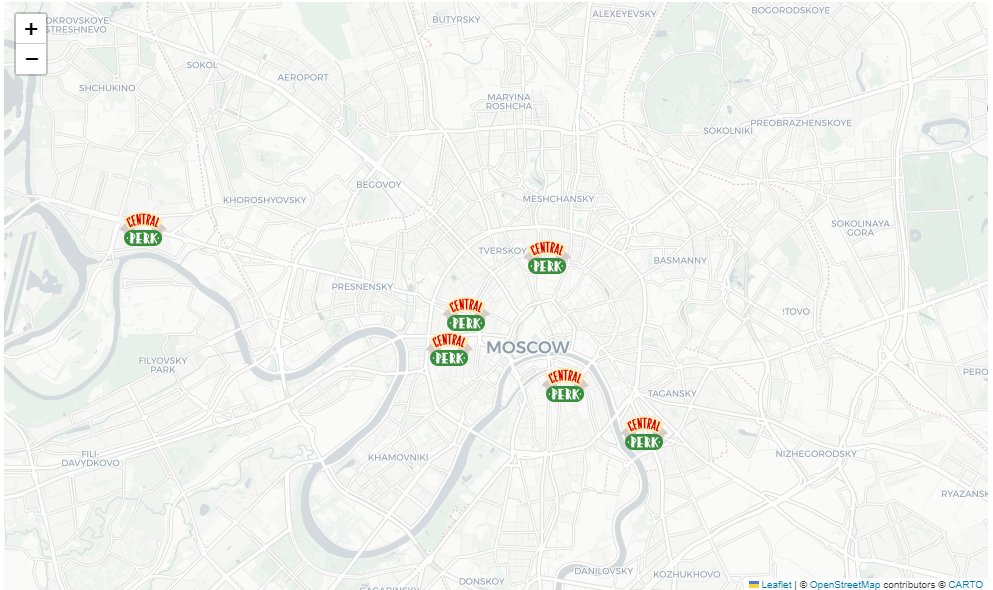

### Вывод

Анализ рынка кофеен Москвы позволил определить ряд параметров, по которым мы провели отбор уже существующих кофеен. В таблице было обнаружено 6 кофеен попадающих под описание нашего проекта. Конкуренция в этой узкой нише невысокая, поэтому мы считаем, что потенциал у такого рода заведений есть. В перспективе может быть открыта небольшая сеть подобных кофеен.